https://github.com/pertusa/InceptionBN-21K-for-Caffe

In [1]:
import caffe
import cv2
import matplotlib.pyplot as plt
import numpy as np
import time
from collections import OrderedDict
import pprint as pp

# Read image using URL
from PIL import Image
import requests
from io import BytesIO

%matplotlib inline

In [2]:
CAFFE_ROOT = '/home/albert/caffe/'
prototxt_file = CAFFE_ROOT + 'models/Inception21k/deploy.prototxt'
caffemodel_file = CAFFE_ROOT + 'models/Inception21k/Inception21k.caffemodel'

In [3]:
net = caffe.Net(prototxt_file, 
                     caffemodel_file, 
                     caffe.TEST)

In [4]:
# for each layer, show the output shape
for layer_name, blob in net.blobs.iteritems():
    print layer_name + '\t' + str(blob.data.shape)

data	(10, 3, 224, 224)
conv_conv1	(10, 96, 112, 112)
pool1	(10, 96, 56, 56)
conv_conv2red	(10, 128, 56, 56)
conv_conv2	(10, 288, 56, 56)
pool2	(10, 288, 28, 28)
pool2_pool2_0_split_0	(10, 288, 28, 28)
pool2_pool2_0_split_1	(10, 288, 28, 28)
pool2_pool2_0_split_2	(10, 288, 28, 28)
pool2_pool2_0_split_3	(10, 288, 28, 28)
conv_3a_1x1	(10, 96, 28, 28)
conv_3a_3x3_reduce	(10, 96, 28, 28)
conv_3a_3x3	(10, 96, 28, 28)
conv_3a_double_3x3_reduce	(10, 96, 28, 28)
conv_3a_double_3x3_0	(10, 144, 28, 28)
conv_3a_double_3x3_1	(10, 144, 28, 28)
ave_pool_3a_pool	(10, 288, 28, 28)
conv_3a_proj	(10, 48, 28, 28)
ch_concat_3a_chconcat	(10, 384, 28, 28)
ch_concat_3a_chconcat_ch_concat_3a_chconcat_0_split_0	(10, 384, 28, 28)
ch_concat_3a_chconcat_ch_concat_3a_chconcat_0_split_1	(10, 384, 28, 28)
ch_concat_3a_chconcat_ch_concat_3a_chconcat_0_split_2	(10, 384, 28, 28)
ch_concat_3a_chconcat_ch_concat_3a_chconcat_0_split_3	(10, 384, 28, 28)
conv_3b_1x1	(10, 96, 28, 28)
conv_3b_3x3_reduce	(10, 96, 28, 28)
conv_3

In [5]:
# The param shapes typically have the form 
# (output_channels, input_channels, filter_height, filter_width) (for the weights) 
# and the 1-dimensional shape (output_channels,) (for the biases).
for layer_name, param in net.params.iteritems():
    print layer_name + '\t' + str(param[0].data.shape), str(param[1].data.shape)

conv_conv1	(96, 3, 7, 7) (96,)
bn_conv1	(96,) (96,)
scale_conv_conv1	(96,) (96,)
conv_conv2red	(128, 96, 1, 1) (128,)
bn_conv2red	(128,) (128,)
scale_conv_conv2red	(128,) (128,)
conv_conv2	(288, 128, 3, 3) (288,)
bn_conv2	(288,) (288,)
scale_conv_conv2	(288,) (288,)
conv_3a_1x1	(96, 288, 1, 1) (96,)
bn_3a_1x1	(96,) (96,)
scale_conv_3a_1x1	(96,) (96,)
conv_3a_3x3_reduce	(96, 288, 1, 1) (96,)
bn_3a_3x3_reduce	(96,) (96,)
scale_conv_3a_3x3_reduce	(96,) (96,)
conv_3a_3x3	(96, 96, 3, 3) (96,)
bn_3a_3x3	(96,) (96,)
scale_conv_3a_3x3	(96,) (96,)
conv_3a_double_3x3_reduce	(96, 288, 1, 1) (96,)
bn_3a_double_3x3_reduce	(96,) (96,)
scale_conv_3a_double_3x3_reduce	(96,) (96,)
conv_3a_double_3x3_0	(144, 96, 3, 3) (144,)
bn_3a_double_3x3_0	(144,) (144,)
scale_conv_3a_double_3x3_0	(144,) (144,)
conv_3a_double_3x3_1	(144, 144, 3, 3) (144,)
bn_3a_double_3x3_1	(144,) (144,)
scale_conv_3a_double_3x3_1	(144,) (144,)
conv_3a_proj	(48, 288, 1, 1) (48,)
bn_3a_proj	(48,) (48,)
scale_conv_3a_proj	(48,) (48,)
c

In [6]:
img = cv2.imread(CAFFE_ROOT + 'examples/images/cat.jpg')
img = cv2.resize(img, (224,224))

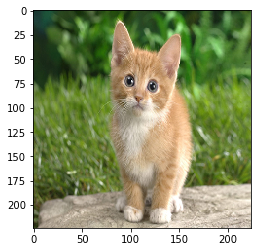

In [7]:
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

In [8]:
caffe.set_mode_gpu()

start = time.time()
net.blobs['data'].data[0, ...] = img.transpose(2, 0, 1)
output = net.forward()
output_prob = output['softmax'][0]

print 'predicted class is:', output_prob.argmax()
print('Time: %.4f' % (time.time() - start))

predicted class is: 641
Time: 0.1942


In [9]:
labels_file = CAFFE_ROOT + 'models/Inception21k/synset.txt'
labels_str = np.loadtxt(labels_file, str, delimiter='\t')

labels_dict = OrderedDict([])
for l in labels_str:
    wnid = l[:l.index(' ')]
    description = l[l.index(' '):].strip(' ')
    labels_dict.update({wnid : description})

print 'output label:', labels_dict.items()[output_prob.argmax()]

output label: ('n02122948', 'Kitten, kitty')


In [11]:
# sort top five predictions from softmax output
top_inds = output_prob.argsort()[::-1][:5]  # reverse sort and take five largest items

print 'probabilities and labels:'
pp.pprint(zip(output_prob[top_inds], np.array(labels_dict.items())[top_inds]))

probabilities and labels:
[(0.11175844, array(['n02122948', 'Kitten, kitty'],
      dtype='|S175')),
 (0.10219875, array(['n02120997', 'Feline, felid'],
      dtype='|S175')),
 (0.095541105, array(['n02124484', 'Manx, Manx cat'],
      dtype='|S175')),
 (0.064516336,
  array(['n01884203', 'Native cat, Dasyurus viverrinus'],
      dtype='|S175')),
 (0.055845521,
  array(['n02122298', 'Kitty, kitty-cat, puss, pussy, pussycat'],
      dtype='|S175'))]


### Evaluate Performance

Unable to get ImageNet full dataset with correct (specific) labels.
http://image-net.org/download-imageurls

In [12]:
test_img_url_file = CAFFE_ROOT + 'data/imagenet/winter11_urls.txt'

test_img_urls = []
n_imgs = 1000
with open(test_img_url_file, 'r') as f:
    i = 0
    t = 0
    for line in f:
        if t % 10 == 0:
            if i == n_imgs:
                break
            test_img_urls.append([])
            url = line.replace('\t', ' ').replace('\n', '')
            wnid = url[:url.index('_')]
            description = url[url.index(' '):].strip(' ')
            test_img_urls[i] = [wnid, description]
            i += 1
        t += 1

In [13]:
def evaluate_rank(net, img_list, labels_dict, rank):
    correct = 0
    total = 0
    i = 0
    for l, url in img_list:
        try:
            response = requests.get(url)
            img = np.array(Image.open(BytesIO(response.content)))
            plt.imshow(img)
            plt.show()
            img = cv2.resize(img, (224, 224)).transpose(2, 0, 1)

            net.blobs['data'].data[0, ...] = img
            output = net.forward()
            output_prob = output['softmax'][0]
            top_inds = output_prob.argsort()[::-1][:rank]
            output_classes = np.array(labels_dict.keys())[top_inds.tolist()]

            pp.pprint(zip(output_prob[top_inds], labels_str[top_inds]))
            print('Correct class: %s, %s' % (l, labels_dict[l]))

            if any(l == c for c in output_classes):
                correct += 1
            
            if total % 50 == 0 and total > 0:
                print('Images tested: %d, Score: %.4f' % 
                      (total, float(correct)/total))
            total += 1
        except Exception:
            pass
        i += 1
        print(i)
    print('Done! %s total images tested.' % total)
    return float(correct)/total

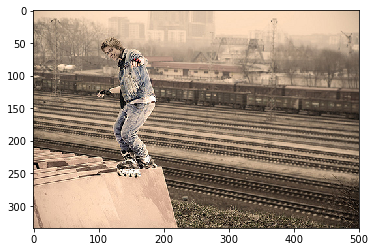

[(0.53235734, 'n04439712 Tinfoil, tin foil'),
 (0.066883624, 'n04135710 Cling film, clingfilm, Saran Wrap'),
 (0.05084987, 'n04525584 Venetian blind'),
 (0.04284513, 'n03635330 Lame'),
 (0.038395621, 'n03958752 Plastic wrap')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
1


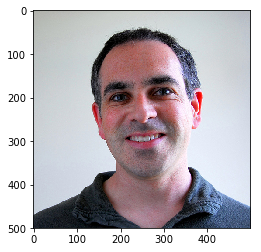

[(0.18189226, 'n04272054 Spectacles, specs, eyeglasses, glasses'),
 (0.073733389, 'n03783430 Monocle, eyeglass'),
 (0.060793765, 'n04355933 Sunglass'),
 (0.038147565, 'n04356056 Sunglasses, dark glasses, shades'),
 (0.027008785, 'n03359137 Flashlight, torch')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
2


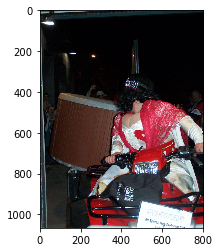

[(0.46736154, 'n04414675 Tesla coil'),
 (0.16117053, 'n04571958 Weld'),
 (0.14416212, 'n03864692 Overhead projector'),
 (0.034144171, 'n03665366 Light, light source'),
 (0.030491237, 'n04439712 Tinfoil, tin foil')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
3
4
5


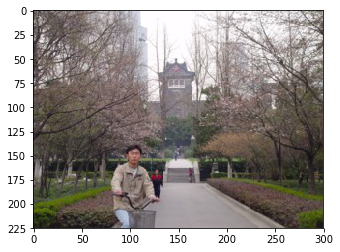

[(0.048919208, 'n04951875 Sunniness'),
 (0.030666096, 'n04953296 Glint'),
 (0.021325165, 'n09945745 Commuter'),
 (0.02027493, 'n04096066 Road, route'),
 (0.018124567, 'n11508382 Snow, snowfall')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
6


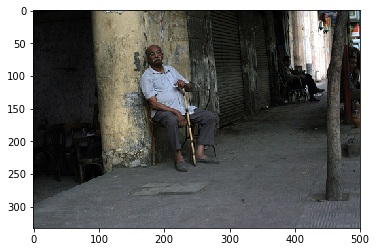

[(0.16905074, 'n03071160 Colonnade'),
 (0.11964443, 'n04501370 Turnstile'),
 (0.028259268, 'n04189816 Sheetrock'),
 (0.020186111, 'n03592245 Jail, jailhouse, gaol, clink, slammer, poky, pokey'),
 (0.01679478, 'n04334599 Street')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
7


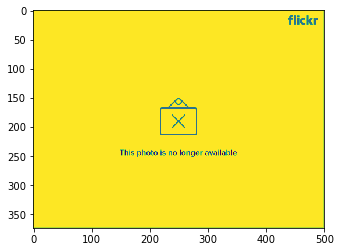

8


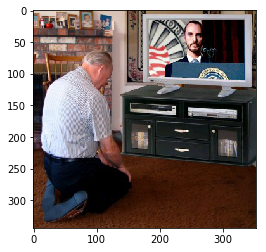

[(0.035363719, 'n04093625 Rink, skating rink'),
 (0.030464506, 'n04404412 Television, television system'),
 (0.028750801, 'n06277280 Television, telecasting, TV, video'),
 (0.028438699, 'n02799323 Baseball cap, jockey cap, golf cap'),
 (0.020707613,
  'n02977058 Cash machine, cash dispenser, automated teller machine, automatic teller machine, automated teller, automatic teller, ATM')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
9


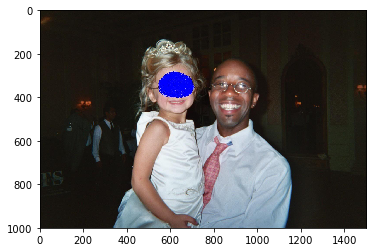

[(0.37413073, 'n04229816 Ski mask'),
 (0.23011968, 'n03375575 Foil'),
 (0.050835047, 'n03666362 Light-emitting diode, LED'),
 (0.029791158, 'n03327691 Fencing sword'),
 (0.021190146, 'n03320519 Fancy dress, masquerade, masquerade costume')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
10
11
12


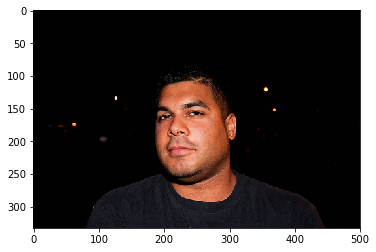

[(0.32384247, 'n07600285 Bubble gum'),
 (0.25352111, 'n03817191 Negative'),
 (0.045985855, 'n02474777 Homo sapiens'),
 (0.030090917, 'n04229816 Ski mask'),
 (0.014855794, 'n07599998 Chewing gum, gum')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
13


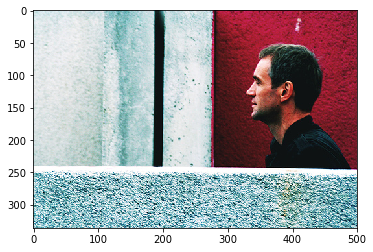

[(0.40453768, 'n07600285 Bubble gum'),
 (0.15546674, 'n07599998 Chewing gum, gum'),
 (0.062885433, 'n02769669 Backlighting'),
 (0.039282735, 'n03817191 Negative'),
 (0.018808397, 'n03666362 Light-emitting diode, LED')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
14


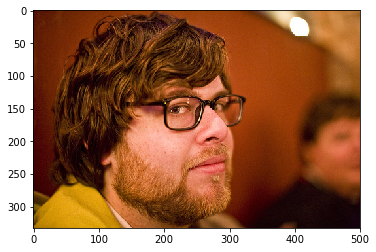

[(0.11141, 'n13905792 Wrinkle, furrow, crease, crinkle, seam, line'),
 (0.07290715, 'n10345015 Nan'),
 (0.04193227,
  'n10142747 Grandma, grandmother, granny, grannie, gran, nan, nanna'),
 (0.019448146, 'n05263183 Stubble'),
 (0.019015558, 'n04584207 Wig')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
15


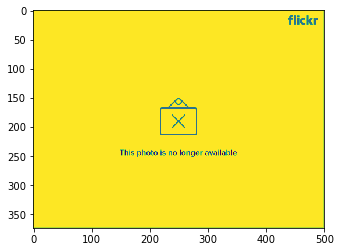

16


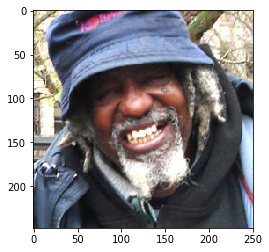

[(0.19520421, 'n03336575 Filament'),
 (0.13062641, 'n03666362 Light-emitting diode, LED'),
 (0.11765086, 'n03318294 Fairy light'),
 (0.10564456, 'n04439712 Tinfoil, tin foil'),
 (0.079787903, 'n04263760 Source of illumination')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
17


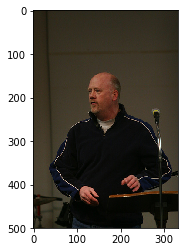

[(0.077190027, 'n04039742 Racquetball'),
 (0.071388558, 'n02909053 Bubble'),
 (0.037842978, 'n09229709 Bubble'),
 (0.033055902, 'n10396106 Panelist, panellist'),
 (0.028049417, 'n10631309 Speaker')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
18


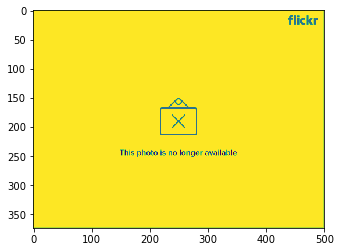

19


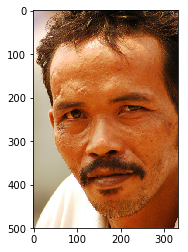

[(0.14292185, 'n04357314 Sunscreen, sunblock, sun blocker'),
 (0.064835459, 'n04186051 Shaving cream, shaving soap'),
 (0.039934751, 'n09747495 Gambian'),
 (0.039098933, 'n09637339 Black woman'),
 (0.027123287, 'n09734639 Tuareg')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
20


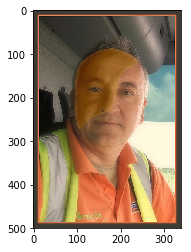

[(0.52965909, 'n03817191 Negative'),
 (0.066887371, 'n03040376 Clean room, white room'),
 (0.035344109, 'n04495698 Tudung'),
 (0.01698135, 'n02769075 Background, desktop, screen background'),
 (0.01229776, 'n03484931 Hand glass, simple microscope, magnifying glass')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
21


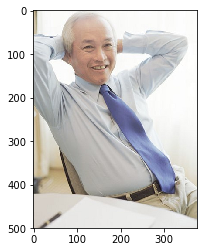

[(0.06823986, 'n10281896 Mahatma'),
 (0.037202522, 'n04439712 Tinfoil, tin foil'),
 (0.032941602, 'n04339879 Strip lighting'),
 (0.025395188,
  'n03358172 Flash, photoflash, flash lamp, flashgun, flashbulb, flash bulb'),
 (0.024513576, 'n04209133 Shower cap')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
22


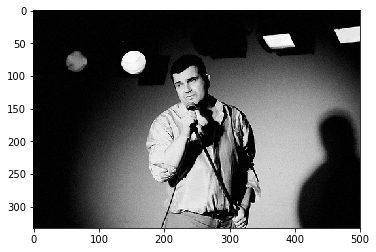

[(0.15381491, 'n10226413 Juggler'),
 (0.076587424, 'n04286575 Spotlight, spot'),
 (0.071152769, 'n03666362 Light-emitting diode, LED'),
 (0.060522117, 'n03318294 Fairy light'),
 (0.031857502, 'n10539015 Ropewalker, ropedancer')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
23


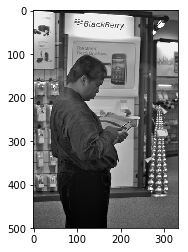

[(0.49389219, 'n02760199 Automat'),
 (0.27710125, 'n02760099 Automat'),
 (0.045453012, 'n04525305 Vending machine'),
 (0.037845153, 'n04501370 Turnstile'),
 (0.024763379, 'n02963302 Card index, card catalog, card catalogue')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
24


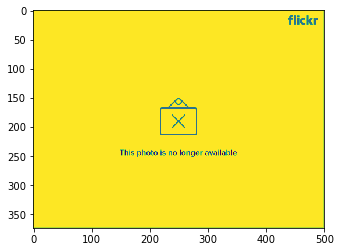

25


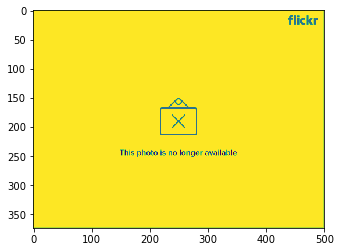

26


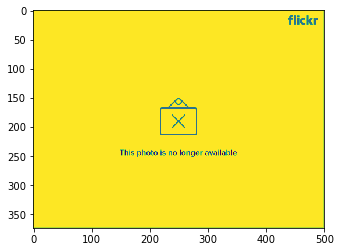

27


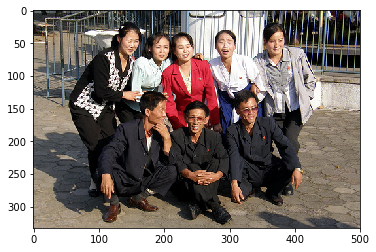

[(0.11243941, 'n10282672 Maid, maidservant, housemaid, amah'),
 (0.098993771, 'n03665366 Light, light source'),
 (0.084690422, 'n10763383 Waiter, server'),
 (0.067851201, 'n10559288 Schoolchild, school-age child, pupil'),
 (0.040874016, 'n09843824 Baton twirler, twirler')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
28


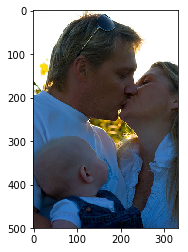

[(0.092937723, 'n03318294 Fairy light'),
 (0.092252381, 'n10267311 Little brother'),
 (0.048249956, 'n03241335 Drinking fountain, water fountain, bubbler'),
 (0.041496318, 'n07600285 Bubble gum'),
 (0.041201081, 'n10237196 Kisser, osculator')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
29


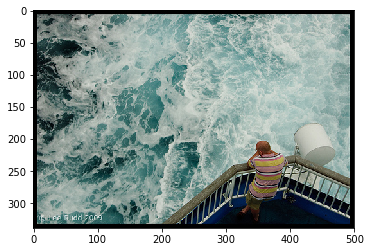

[(0.082573324,
  'n02788148 Bannister, banister, balustrade, balusters, handrail'),
 (0.08143685, 'n03369866 Flume'),
 (0.043239571, 'n04335886 Streetlight, street lamp'),
 (0.03089273,
  'n03549732 Hurricane deck, hurricane roof, promenade deck, awning deck'),
 (0.029040998, 'n03447447 Gondola')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
30


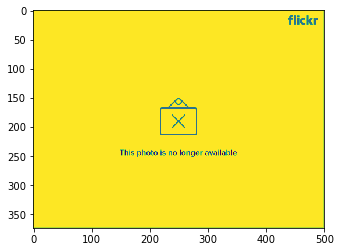

31


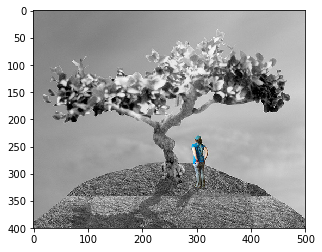

[(0.15741219, 'n09218641 Ben'),
 (0.065886669, 'n09785659 Alpinist'),
 (0.061059229, 'n09303008 Hill'),
 (0.058288574, 'n09361517 Mountainside, versant'),
 (0.047709506, 'n12916179 Black mangrove, Aegiceras majus')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
32


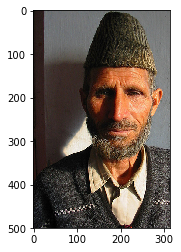

[(0.60104537, 'n04439712 Tinfoil, tin foil'),
 (0.064239964, 'n04229816 Ski mask'),
 (0.046795599, 'n04209133 Shower cap'),
 (0.029829973, 'n03635330 Lame'),
 (0.017439025, 'n03065243 Coif')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
33


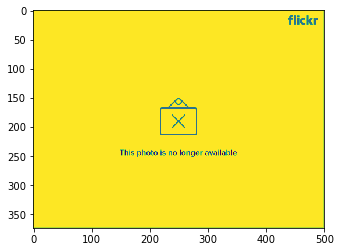

34


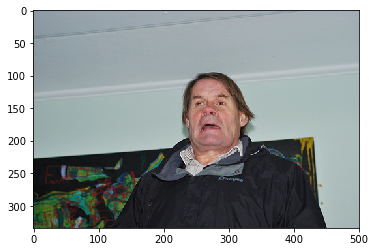

[(0.15335029, 'n10602470 Sister'),
 (0.076475017, 'n04049405 Raincoat, waterproof'),
 (0.035784643, 'n04439712 Tinfoil, tin foil'),
 (0.026293576, 'n09606527 Anomaly, unusual person'),
 (0.025639357, 'n02667093 Abaya')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
35


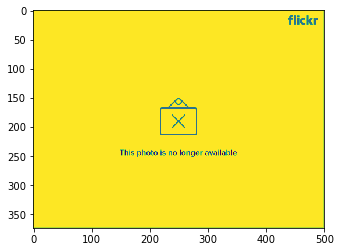

36


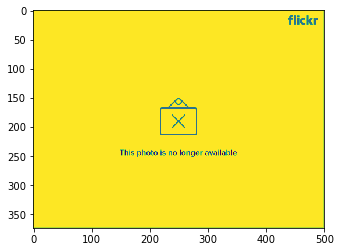

37


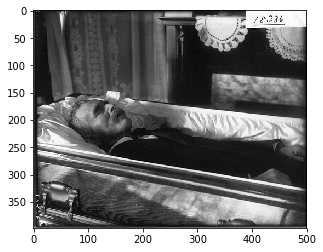

[(0.62603718, 'n04339879 Strip lighting'),
 (0.080066681, 'n04439712 Tinfoil, tin foil'),
 (0.014334753, 'n04590129 Window shade'),
 (0.011491317, 'n02981321 Catalytic converter'),
 (0.011363692, 'n02851099 Blind, screen')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
38


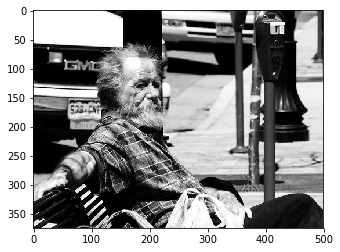

[(0.13593997, 'n04339879 Strip lighting'),
 (0.071577899, 'n03255030 Dumbbell'),
 (0.063685589, 'n04439712 Tinfoil, tin foil'),
 (0.062517144, 'n04501370 Turnstile'),
 (0.052632317, 'n03759954 Microphone, mike')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
39


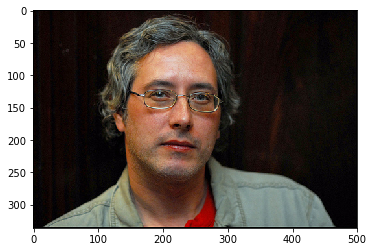

[(0.060064748, 'n04584207 Wig'),
 (0.04356866, 'n07600285 Bubble gum'),
 (0.029995006, 'n03817191 Negative'),
 (0.029751793, 'n02474777 Homo sapiens'),
 (0.028361646, 'n04459018 Toupee, toupe')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
40


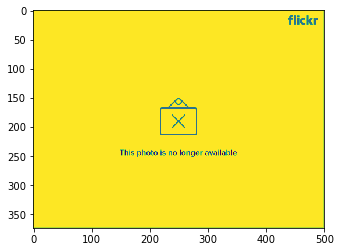

41


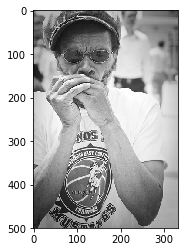

[(0.035473637, 'n03438257 Glass, drinking glass'),
 (0.027489154, 'n03521675 Hipflask, pocket flask'),
 (0.027331294, 'n03484931 Hand glass, simple microscope, magnifying glass'),
 (0.026656112, "n03692522 Loupe, jeweler's loupe"),
 (0.023141811, 'n03973839 Pocket watch')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
42


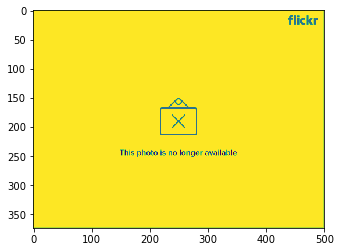

43


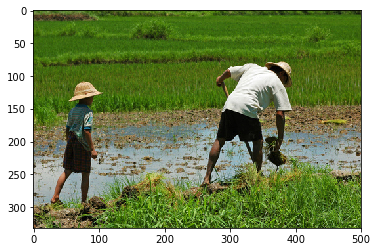

[(0.14764012, 'n10079399 Farmhand, fieldhand, field hand, farm worker'),
 (0.086313404, 'n10078806 Farmer, husbandman, granger, sodbuster'),
 (0.066618815, 'n03334382 Fieldwork'),
 (0.05404447, 'n10410996 Peasant'),
 (0.047252204, 'n12926480 Cassava, casava')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
44


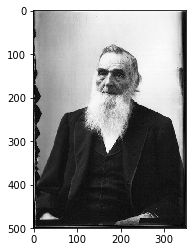

[(0.038181111,
  'n03665924 Light bulb, lightbulb, bulb, incandescent lamp, electric light, electric-light bulb'),
 (0.033275396, 'n03358380 Flash'),
 (0.032480802,
  'n03358172 Flash, photoflash, flash lamp, flashgun, flashbulb, flash bulb'),
 (0.024963772, 'n04339879 Strip lighting'),
 (0.02390717, 'n02883205 Bow tie, bow-tie, bowtie')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
45


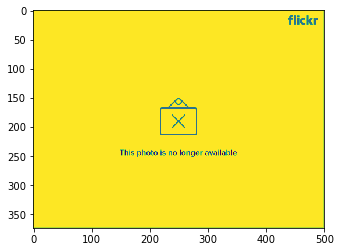

46


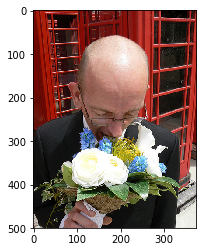

[(0.18817841, 'n13864035 Bulb'),
 (0.11107387, 'n03665366 Light, light source'),
 (0.069368929, 'n03666362 Light-emitting diode, LED'),
 (0.054011796, 'n04263760 Source of illumination'),
 (0.032809082, 'n04107743 Room light')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
47


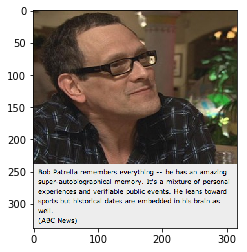

[(0.12434538, 'n03783430 Monocle, eyeglass'),
 (0.068735756, 'n03484931 Hand glass, simple microscope, magnifying glass'),
 (0.061274238, 'n04186051 Shaving cream, shaving soap'),
 (0.041263621, 'n04272054 Spectacles, specs, eyeglasses, glasses'),
 (0.030085701, 'n03709206 Magnifier')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
48


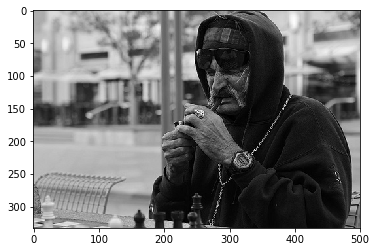

[(0.058447216, 'n03783430 Monocle, eyeglass'),
 (0.051445127, 'n09847543 Beldam, beldame'),
 (0.043737717, 'n03484931 Hand glass, simple microscope, magnifying glass'),
 (0.033715509, 'n03868863 Oxygen mask'),
 (0.029730204, "n03692522 Loupe, jeweler's loupe")]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
49


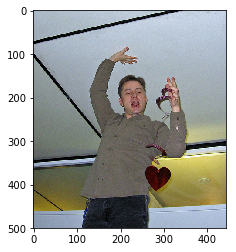

[(0.15001647, 'n03327691 Fencing sword'),
 (0.10417403, 'n03548402 Hula-hoop'),
 (0.035414509, 'n04121511 Saber, sabre'),
 (0.027580846, 'n03375575 Foil'),
 (0.021149106, 'n04229816 Ski mask')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
50


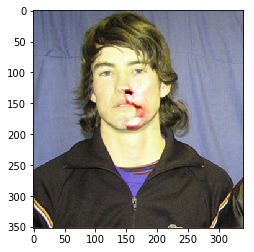

[(0.14777592, 'n03484931 Hand glass, simple microscope, magnifying glass'),
 (0.051325299, 'n03783430 Monocle, eyeglass'),
 (0.049967516, 'n07599998 Chewing gum, gum'),
 (0.042753018, 'n07935737 Bottled water'),
 (0.031811304, 'n03725035 Mask')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
51


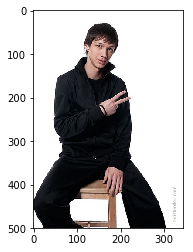

[(0.3610467, 'n04332580 Straitjacket, straightjacket'),
 (0.06458085, 'n03864692 Overhead projector'),
 (0.064277254, 'n03255030 Dumbbell'),
 (0.025209485, 'n04339879 Strip lighting'),
 (0.021801431, 'n10178216 Hitter, striker')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
52


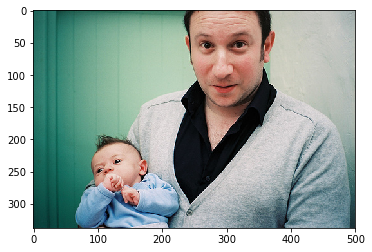

[(0.14320844, 'n03725035 Mask'),
 (0.12131038, 'n03358380 Flash'),
 (0.059096418, 'n03410740 Gag, muzzle'),
 (0.032582652, 'n03724870 Mask'),
 (0.032424439, 'n10020890 Doctor, doc, physician, MD, Dr., medico')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
53


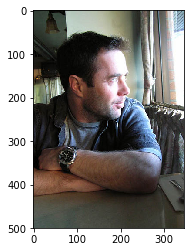

[(0.10841361, 'n04439712 Tinfoil, tin foil'),
 (0.048098888, 'n04162706 Seat belt, seatbelt'),
 (0.045104776, 'n02770830 Backseat'),
 (0.025095897, 'n03505133 Headrest'),
 (0.02319451, 'n03349892 First class')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
54


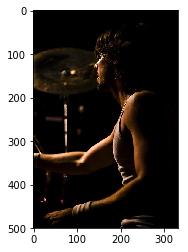

[(0.52826047, 'n09229709 Bubble'),
 (0.14663905, 'n03336575 Filament'),
 (0.13149518, 'n02909053 Bubble'),
 (0.027875371, 'n09191635 Air bubble'),
 (0.016566517, 'n07935504 Water')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
55


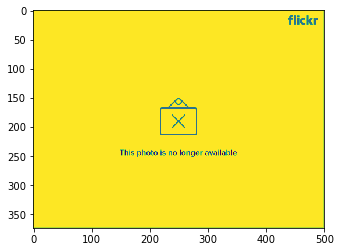

56


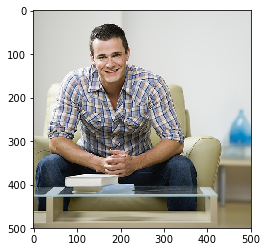

[(0.056203663, 'n04339879 Strip lighting'),
 (0.029943742, 'n04542943 Waffle iron'),
 (0.020441778, 'n03115897 Couch'),
 (0.014624875, 'n10684630 Swot, grind, nerd, wonk, dweeb'),
 (0.014539279, 'n04080138 Resonator')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
57


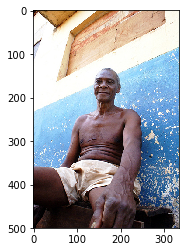

[(0.10132551, 'n04339879 Strip lighting'),
 (0.070865028, 'n09945745 Commuter'),
 (0.042852767, 'n04135710 Cling film, clingfilm, Saran Wrap'),
 (0.03466823,
  'n02862048 Body armor, body armour, suit of armor, suit of armour, coat of mail, cataphract'),
 (0.02034599, 'n03410740 Gag, muzzle')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
58


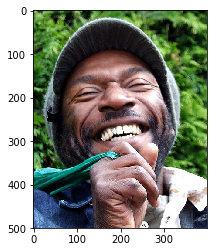

[(0.073409364, 'n03370387 Fluorescent lamp'),
 (0.05581373, 'n04579432 Whistle'),
 (0.050639056, 'n09620794 Native, indigen, indigene, aborigine, aboriginal'),
 (0.048132062, 'n09637339 Black woman'),
 (0.04772567, 'n03372029 Flute, transverse flute')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
59


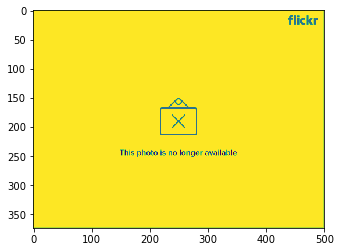

60


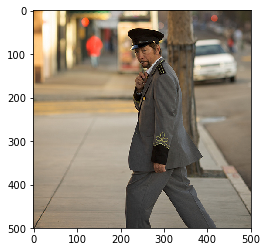

[(0.12588045, 'n04059157 Ready-to-wear'),
 (0.10884573, 'n10721321 Traffic cop'),
 (0.070436925, 'n04427715 Three-piece suit'),
 (0.051718805, 'n03642444 Lapel'),
 (0.044509839, 'n03815615 Necktie, tie')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
61


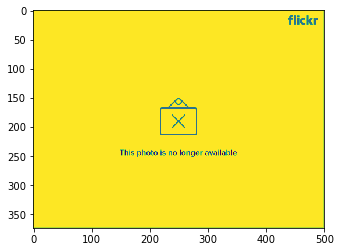

62


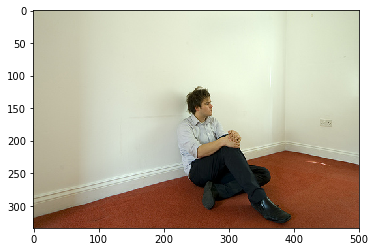

[(0.15199392, 'n03327691 Fencing sword'),
 (0.049033292, 'n03375575 Foil'),
 (0.04575425, "n03327553 Fencing mask, fencer's mask"),
 (0.042965133, 'n00120010 Hop'),
 (0.042706665, 'n02790996 Barbell')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
63


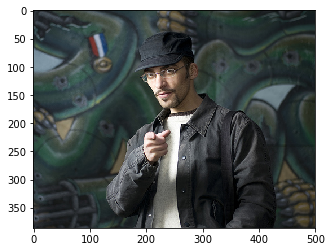

[(0.22689337, 'n02739668 Armor, armour'),
 (0.16868472,
  'n02740764 Armor plate, armour plate, armor plating, plate armor, plate armour'),
 (0.05660456,
  'n02862048 Body armor, body armour, suit of armor, suit of armour, coat of mail, cataphract'),
 (0.048154712, 'n02895154 Breastplate, aegis, egis'),
 (0.033611443, 'n04571958 Weld')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
64


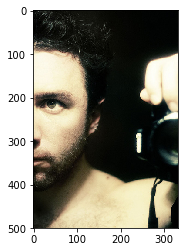

[(0.52694875, 'n03318294 Fairy light'),
 (0.065189205, 'n04953296 Glint'),
 (0.038876541, 'n04107743 Room light'),
 (0.0335491, 'n04286575 Spotlight, spot'),
 (0.033153534, 'n03359137 Flashlight, torch')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
65


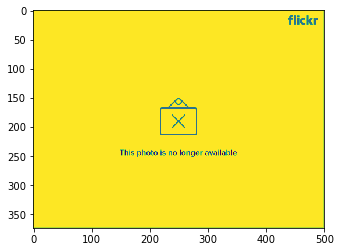

66


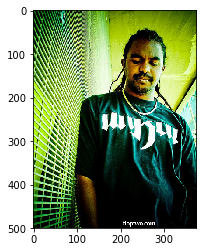

[(0.39572394, 'n04339879 Strip lighting'),
 (0.050669137, 'n03730655 Matrix'),
 (0.038040195, 'n09636339 Black, Black person, blackamoor, Negro, Negroid'),
 (0.032862984, 'n03667235 Lighting'),
 (0.023911703, 'n03818343 Neon lamp, neon induction lamp, neon tube')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
67


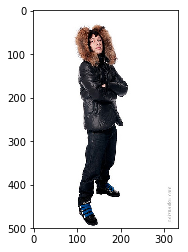

[(0.35326654, 'n00120010 Hop'),
 (0.12360524, 'n04251791 Snowboard'),
 (0.035832543, 'n10115946 Funambulist, tightrope walker'),
 (0.033756007, 'n03623198 Knee pad'),
 (0.031374201, 'n04339879 Strip lighting')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
68


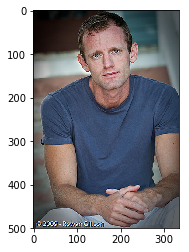

[(0.08948011, 'n03817191 Negative'),
 (0.041872505, 'n03814639 Neck brace'),
 (0.028438793, 'n02785648 Bandage, patch'),
 (0.026012868, 'n04162706 Seat belt, seatbelt'),
 (0.025992682, 'n04439712 Tinfoil, tin foil')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
69


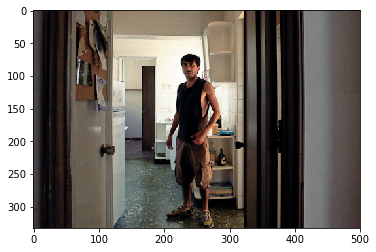

[(0.21610108, 'n04329834 Storm door'),
 (0.15441675, 'n04239074 Sliding door'),
 (0.07723707, 'n03365592 Floor, flooring'),
 (0.04478848, 'n03394649 French door'),
 (0.041368209, 'n04086446 Revolving door, revolver')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
70


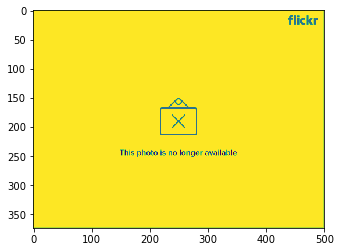

71


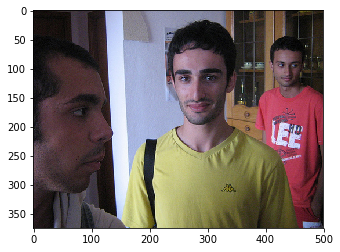

[(0.19740205, 'n10300154 Mate'),
 (0.079108804, 'n10267311 Little brother'),
 (0.044675682, 'n09877951 Buddy, brother, chum, crony, pal, sidekick'),
 (0.029776348, 'n10095769 Flatmate'),
 (0.025609594, 'n10200781 Important person, influential person, personage')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
72


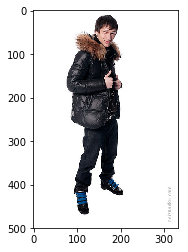

[(0.12715583, 'n03359137 Flashlight, torch'),
 (0.066967949, 'n04101701 Roller'),
 (0.062257923, 'n03623198 Knee pad'),
 (0.061167624, 'n04339879 Strip lighting'),
 (0.046832424, 'n04286575 Spotlight, spot')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
Images tested: 50, Score: 0.0000
73


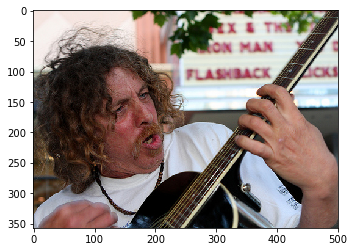

[(0.10491022, 'n02787622 Banjo'),
 (0.08534804, 'n10151760 Guitarist, guitar player'),
 (0.057408374, 'n04373894 Sword, blade, brand, steel'),
 (0.052536592, 'n03332271 Fiddlestick, violin bow'),
 (0.038125437, 'n10340312 Musician, instrumentalist, player')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
74


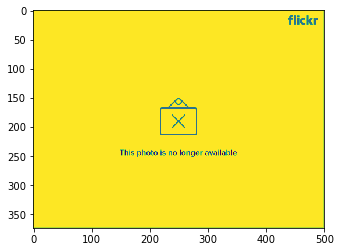

75


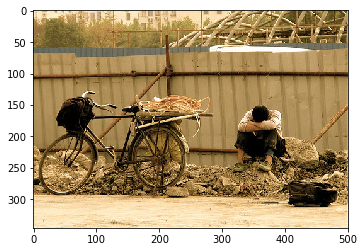

[(0.61905533, 'n04026813 Push-bike'),
 (0.1725684, 'n04126066 Safety bicycle, safety bike'),
 (0.10684363, 'n00451563 Bicycling'),
 (0.020767609, 'n02834778 Bicycle, bike, wheel, cycle'),
 (0.014717818, 'n03883524 Pannier')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
76


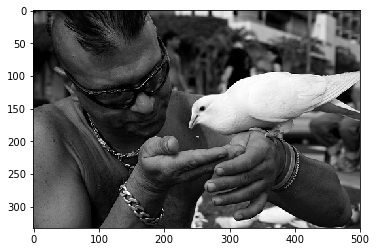

[(0.38024357,
  'n01819734 Cockateel, cockatiel, cockatoo parrot, Nymphicus hollandicus'),
 (0.28545165, 'n01625562 Barn owl, Tyto alba'),
 (0.077255882, 'n09856401 Bird fancier'),
 (0.053429138, 'n01814921 Homing pigeon, homer'),
 (0.052073818, 'n01819115 Cockatoo')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
77


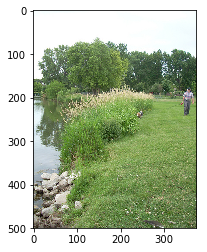

[(0.093088776, 'n04289195 Sprinkler system'),
 (0.03923744, 'n00445055 Surfing, surfboarding, surfriding'),
 (0.034002058, 'n09436444 Ski slope'),
 (0.030451966, 'n09228055 Brae'),
 (0.023953799, 'n00442847 Dip, plunge')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
78


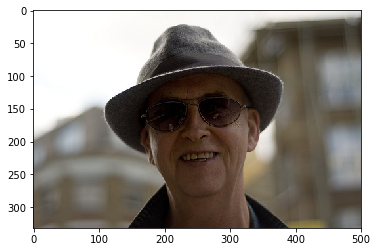

[(0.24506415, 'n03817191 Negative'),
 (0.21337727, 'n04356595 Sunhat, sun hat'),
 (0.053452428, 'n03325941 Fedora, felt hat, homburg, Stetson, trilby'),
 (0.043257918, 'n03206718 Disguise'),
 (0.032024711, 'n03124170 Cowboy hat, ten-gallon hat')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
79


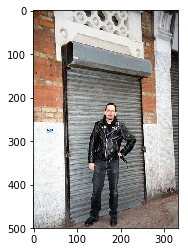

[(0.33355007,
  'n02862048 Body armor, body armour, suit of armor, suit of armour, coat of mail, cataphract'),
 (0.11308721, 'n04266375 Spacesuit'),
 (0.039438263, 'n04001845 Pressure suit'),
 (0.031502262, 'n03875806 Paintball'),
 (0.030814506, 'n02739668 Armor, armour')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
80


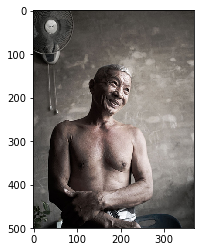

[(0.12323279, 'n02822762 Beefcake'),
 (0.054466765, 'n09439213 Soapsuds, suds, lather'),
 (0.044543851, 'n09229709 Bubble'),
 (0.041917529, 'n09191635 Air bubble'),
 (0.036407642, 'n04499300 Turkish bath')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
81


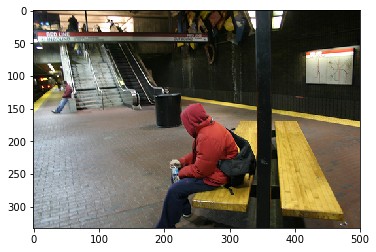

[(0.095830798, 'n04093625 Rink, skating rink'),
 (0.058725622, 'n04189816 Sheetrock'),
 (0.033238884, 'n10773665 Welder'),
 (0.023483092, 'n03558176 Ice rink, ice-skating rink, ice'),
 (0.022852683, 'n04571958 Weld')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
82


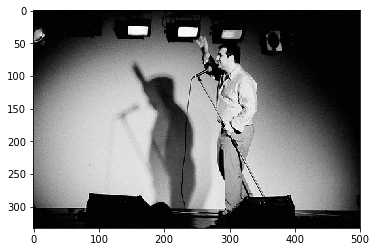

[(0.10809794, 'n03140292 Crucifix, rood, rood-tree'),
 (0.096183464, 'n04339879 Strip lighting'),
 (0.061962403, 'n03135532 Cross'),
 (0.056612618, 'n03666362 Light-emitting diode, LED'),
 (0.03806207, 'n00480366 Jai alai, pelota')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
83


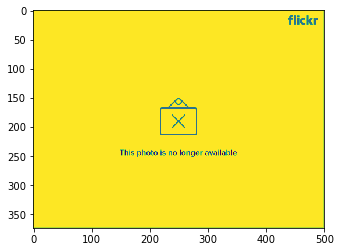

84


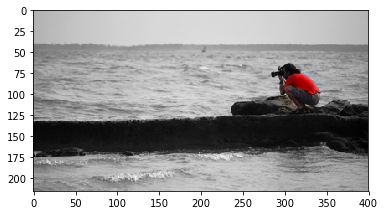

[(0.76737118, 'n00445055 Surfing, surfboarding, surfriding'),
 (0.032057881, 'n09452760 Swell'),
 (0.023847492, 'n00455173 Surf casting, surf fishing'),
 (0.023295976, 'n04562262 Water ski'),
 (0.014596418, 'n11524451 Wave')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
85


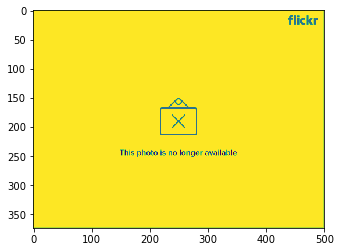

86


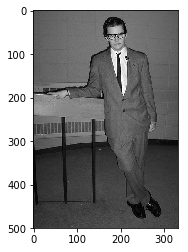

[(0.15208577, 'n03201776 Dinner jacket, tux, tuxedo, black tie'),
 (0.10351289, 'n04504141 Two-piece, two-piece suit, lounge suit'),
 (0.095528387, 'n04350905 Suit, suit of clothes'),
 (0.083341375, 'n04615644 Zoot suit'),
 (0.070901424, 'n04427715 Three-piece suit')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
87


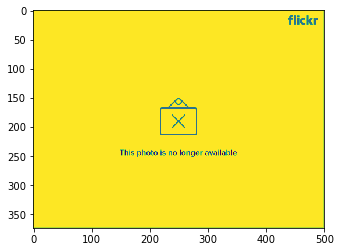

88


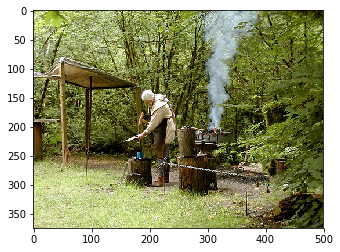

[(0.058518674, 'n04414675 Tesla coil'),
 (0.042640001, 'n08659861 Oilfield'),
 (0.035848077, 'n04549028 Wall tent'),
 (0.03503469, 'n04311595 Steel mill, steelworks, steel plant, steel factory'),
 (0.032976236, 'n03768916 Mineshaft')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
89


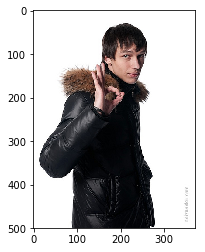

[(0.18601608, 'n03359137 Flashlight, torch'),
 (0.13018416,
  'n03358172 Flash, photoflash, flash lamp, flashgun, flashbulb, flash bulb'),
 (0.04133109, 'n03635330 Lame'),
 (0.03261368, 'n03358380 Flash'),
 (0.027096882, 'n09744161 Nebraskan, Cornhusker')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
90


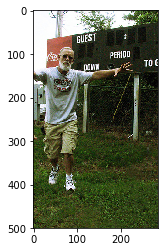

[(0.21283226, 'n10178216 Hitter, striker'),
 (0.071751431, 'n02811059 Batting cage, cage'),
 (0.050872982, 'n03443149 Goalpost'),
 (0.047067855, 'n00467719 Field game'),
 (0.042938735, 'n09843443 Bat boy')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
91


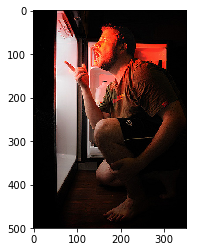

[(0.21385135, 'n04571958 Weld'),
 (0.067598179, 'n04339879 Strip lighting'),
 (0.041269798, 'n04439712 Tinfoil, tin foil'),
 (0.030725172, 'n03318294 Fairy light'),
 (0.030579651, 'n04456115 Torch')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
92


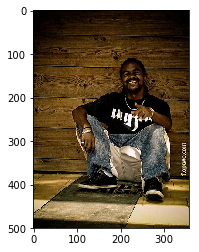

[(0.2156648, 'n02055803 Penguin'),
 (0.049829341, 'n01850192 Bufflehead, butterball, dipper, Bucephela albeola'),
 (0.045739412, 'n02047045 Pigeon guillemot, Cepphus columba'),
 (0.03636197, "n01850553 Barrow's goldeneye, Bucephala islandica"),
 (0.028190926, 'n03914438 Pepper shaker, pepper box, pepper pot')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
93


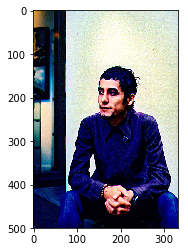

[(0.088382803, 'n04571958 Weld'),
 (0.073939048, 'n10773665 Welder'),
 (0.050964672, 'n04229816 Ski mask'),
 (0.048948992, 'n09838295 Bank robber'),
 (0.048541632, 'n10530150 Rider')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
94


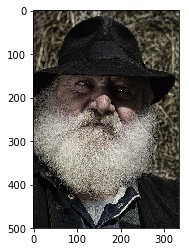

[(0.13134234, 'n04236935 Sleigh bell, cascabel'),
 (0.048512578, 'n04439712 Tinfoil, tin foil'),
 (0.044027206, 'n03929855 Pickelhaube'),
 (0.035340805, 'n03497657 Hat, chapeau, lid'),
 (0.029680494, 'n04356595 Sunhat, sun hat')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
95


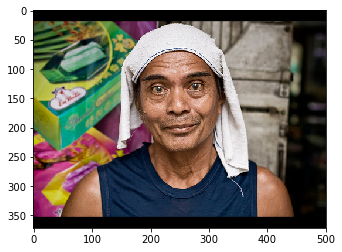

[(0.33308494, 'n03319457 False face'),
 (0.089737214, 'n03725035 Mask'),
 (0.036101982, 'n02846874 Blackface'),
 (0.034131028, 'n03206718 Disguise'),
 (0.033316132, 'n03724870 Mask')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
96


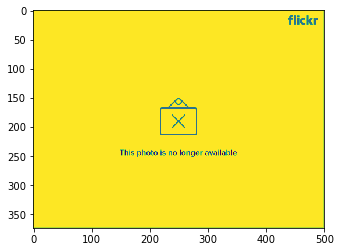

97


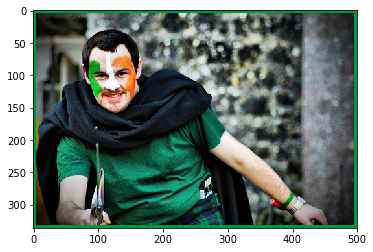

[(0.20569205, 'n10226413 Juggler'),
 (0.055555634, 'n03318294 Fairy light'),
 (0.038055662, 'n03635330 Lame'),
 (0.025692595, 'n03531281 Hood'),
 (0.024685318, 'n04339879 Strip lighting')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
98


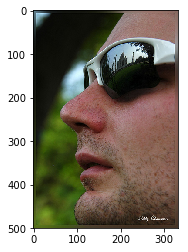

[(0.53488255, 'n04355933 Sunglass'),
 (0.047014326, 'n04356056 Sunglasses, dark glasses, shades'),
 (0.022074314, 'n05263183 Stubble'),
 (0.019262962, 'n09438940 Snowdrift'),
 (0.018883916, 'n10804287 Young buck, young man')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
99


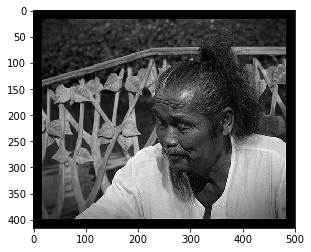

[(0.10720429, 'n09847543 Beldam, beldame'),
 (0.063574977, 'n10362319 Nonsmoker'),
 (0.04122626, 'n03817191 Negative'),
 (0.034112412, 'n03931765 Picture frame'),
 (0.024193801, 'n10034614 Drinker')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
100


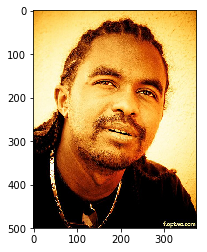

[(0.060627822, 'n09636339 Black, Black person, blackamoor, Negro, Negroid'),
 (0.047771707, 'n09637339 Black woman'),
 (0.024807872, 'n03359137 Flashlight, torch'),
 (0.024699586, 'n09635534 Black African'),
 (0.02014897, 'n09738121 Igbo')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
101


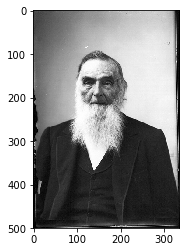

[(0.08827772,
  'n03665924 Light bulb, lightbulb, bulb, incandescent lamp, electric light, electric-light bulb'),
 (0.075176693, 'n03358380 Flash'),
 (0.065251946, 'n04339879 Strip lighting'),
 (0.062269073, 'n03709206 Magnifier'),
 (0.057738509, 'n04340521 Stroboscope, strobe, strobe light')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
102


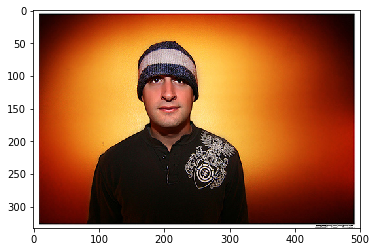

[(0.58069694, 'n10362319 Nonsmoker'),
 (0.095618971, 'n04485423 Triptych'),
 (0.0216417,
  'n03665924 Light bulb, lightbulb, bulb, incandescent lamp, electric light, electric-light bulb'),
 (0.016980739, 'n04968895 Blue, blueness'),
 (0.016268522, 'n03206718 Disguise')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
103


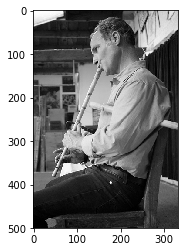

[(0.22178341, 'n03372029 Flute, transverse flute'),
 (0.10629397, 'n04487394 Trombone'),
 (0.092854157, 'n10098245 Flutist, flautist, flute player'),
 (0.042501189, 'n10732010 Trumpeter, cornetist'),
 (0.037125703, 'n10132035 Glassblower')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
104


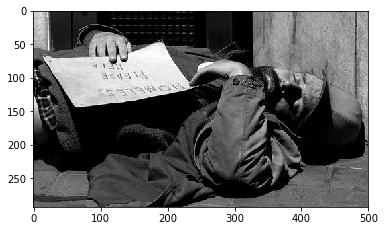

[(0.4812679, 'n10182190 Homeless, homeless person'),
 (0.15056124, 'n10026976 Dosser, street person'),
 (0.065919586, 'n10765679 Wanderer, roamer, rover, bird of passage'),
 (0.023506435, 'n10610465 Sleeper, slumberer'),
 (0.018186571, 'n02088466 Bloodhound, sleuthhound')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
105


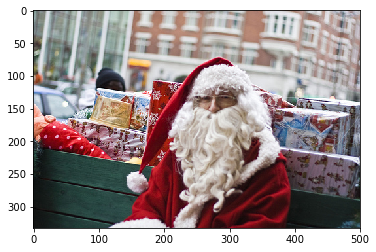

[(0.88546091, 'n04439712 Tinfoil, tin foil'),
 (0.014366172, 'n04414675 Tesla coil'),
 (0.014330143, 'n02895154 Breastplate, aegis, egis'),
 (0.011554833, 'n03666362 Light-emitting diode, LED'),
 (0.0081219897, 'n03318294 Fairy light')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
106


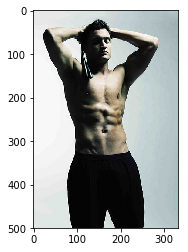

[(0.26114276, 'n03255030 Dumbbell'),
 (0.056582071, 'n02790996 Barbell'),
 (0.05359111, 'n03657511 Leotard, unitard, body suit, cat suit'),
 (0.050071314, 'n02901114 Briefs, Jockey shorts'),
 (0.0470124, 'n04370288 Sweat pants, sweatpants')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
107


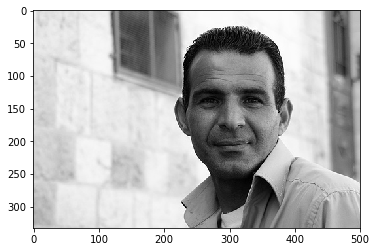

[(0.042945396, 'n10707134 Theosophist'),
 (0.042074572, 'n05263183 Stubble'),
 (0.015521267, 'n10375402 Old man'),
 (0.015513675, 'n10804287 Young buck, young man'),
 (0.014538753, 'n10306595 Melancholic, melancholiac')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
108


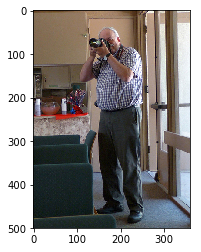

[(0.10325372, 'n04233715 Slacks'),
 (0.065465525, 'n02895154 Breastplate, aegis, egis'),
 (0.051907156, 'n03948459 Pistol, handgun, side arm, shooting iron'),
 (0.04133169, 'n02887489 Brace, suspender, gallus'),
 (0.041248564, 'n02942349 Camcorder')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
109


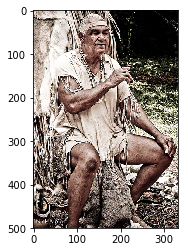

[(0.95014542, 'n04439712 Tinfoil, tin foil'),
 (0.013894705, 'n03635330 Lame'),
 (0.003518966, 'n03375575 Foil'),
 (0.0023354744, 'n02895154 Breastplate, aegis, egis'),
 (0.0021137642, 'n03327691 Fencing sword')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
110


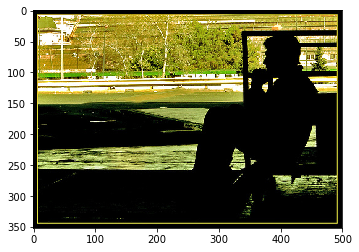

[(0.19301262, 'n02769075 Background, desktop, screen background'),
 (0.11518277, 'n04339879 Strip lighting'),
 (0.07182914, 'n06278475 High-definition television, HDTV'),
 (0.027405363, 'n06277280 Television, telecasting, TV, video'),
 (0.025648501, 'n04260364 Sonogram, echogram')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
111


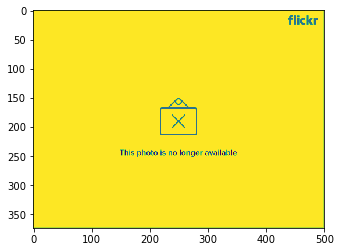

112


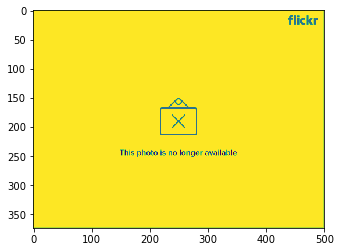

113


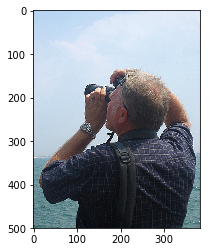

[(0.061844815, 'n04332580 Straitjacket, straightjacket'),
 (0.040986616, 'n03343853 Firearm, piece, small-arm'),
 (0.035273112, 'n03970546 Plush'),
 (0.03156228, 'n03039259 Clay pigeon'),
 (0.025323588, 'n00466273 Professional golf')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
114
115


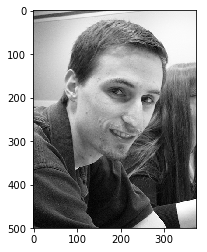

[(0.06974975, 'n04272054 Spectacles, specs, eyeglasses, glasses'),
 (0.062753141, 'n04162706 Seat belt, seatbelt'),
 (0.023406528, 'n04356056 Sunglasses, dark glasses, shades'),
 (0.019996107,
  'n03358172 Flash, photoflash, flash lamp, flashgun, flashbulb, flash bulb'),
 (0.017925335, 'n03318294 Fairy light')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
116


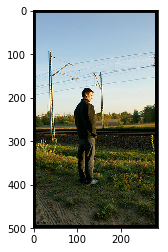

[(0.054475263, 'n00466630 Match play'),
 (0.034529205, 'n03132076 Cricket bat, bat'),
 (0.026061228, 'n04582869 Wicket'),
 (0.01670851, 'n04205062 Short iron'),
 (0.015902327, 'n04951875 Sunniness')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
117


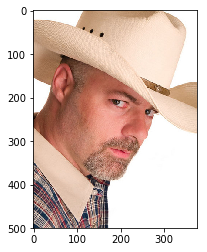

[(0.3988727, 'n03124170 Cowboy hat, ten-gallon hat'),
 (0.22379404, 'n04339879 Strip lighting'),
 (0.039580356, 'n04356595 Sunhat, sun hat'),
 (0.030040069, 'n03492922 Hard hat, tin hat, safety hat'),
 (0.014668901, 'n04292921 Squeegee')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
118


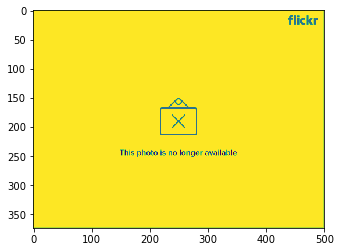

119


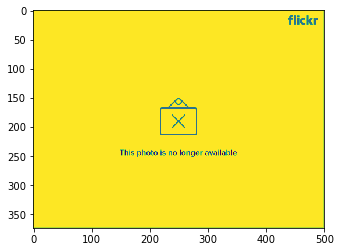

120


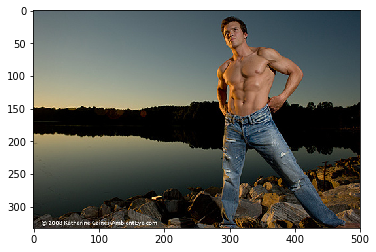

[(0.14420083, 'n13897996 Balance, equilibrium, equipoise, counterbalance'),
 (0.10630137, 'n04319937 Stilt'),
 (0.0847544, 'n02777292 Balance beam, beam'),
 (0.051577326, 'n04469514 Trampoline'),
 (0.037734706, 'n03817191 Negative')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
121


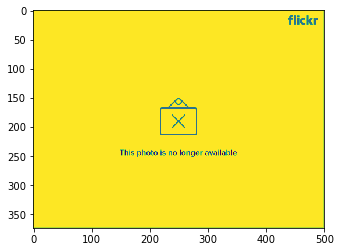

122


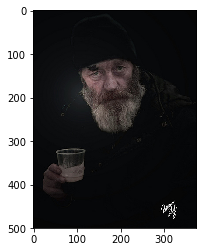

[(0.10261112, 'n04559730 Water gauge, water gage, water glass'),
 (0.072276339, 'n03438257 Glass, drinking glass'),
 (0.069171675, 'n07936263 Drinking water'),
 (0.044348042, 'n04559910 Water glass'),
 (0.042341176, 'n07936459 Ice water')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
123


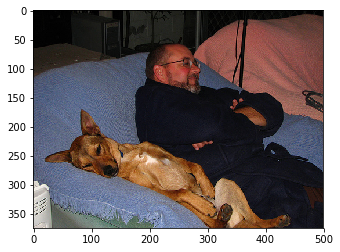

[(0.15048879,
  'n03850245 Operating room, OR, operating theater, operating theatre, surgery'),
 (0.11635396, 'n03868863 Oxygen mask'),
 (0.1103433, 'n04363991 Surgery'),
 (0.075151846, 'n03541091 Hospital room'),
 (0.067427061, 'n02110806 Basenji')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
124


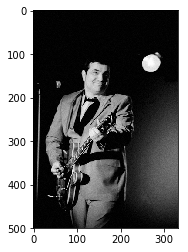

[(0.078615271, 'n10701962 Tenor saxophonist, tenorist'),
 (0.050002318, 'n10151760 Guitarist, guitar player'),
 (0.043183323, 'n10732010 Trumpeter, cornetist'),
 (0.035793986, 'n10340312 Musician, instrumentalist, player'),
 (0.032088488, 'n03467517 Guitar')]
Correct class: n00007846, Person, individual, someone, somebody, mortal, soul
125


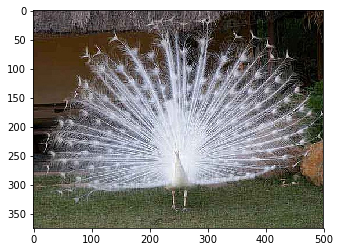

[(0.29692307, 'n03666362 Light-emitting diode, LED'),
 (0.07659696, 'n04953296 Glint'),
 (0.061201703, 'n03388043 Fountain'),
 (0.055361096, 'n04263760 Source of illumination'),
 (0.053040318, 'n04339879 Strip lighting')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
126
127
128


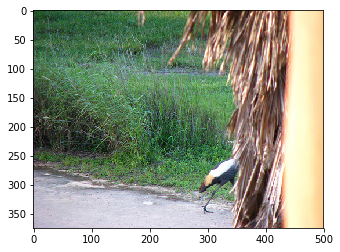

[(0.09014982, 'n04951875 Sunniness'),
 (0.061432526, 'n04339879 Strip lighting'),
 (0.055011492, 'n03958752 Plastic wrap'),
 (0.037304338, 'n04135710 Cling film, clingfilm, Saran Wrap'),
 (0.036912479, 'n04571958 Weld')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
129


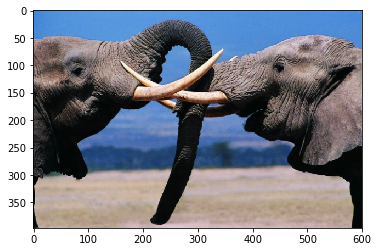

[(0.61600333, 'n02504458 African elephant, Loxodonta africana'),
 (0.14047192, 'n02503517 Elephant'),
 (0.069753446,
  'n02505063 Woolly mammoth, northern mammoth, Mammuthus primigenius'),
 (0.06176478, 'n02505998 Mastodon, mastodont'),
 (0.040165741, 'n02505238 Columbian mammoth, Mammuthus columbi')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
130
131


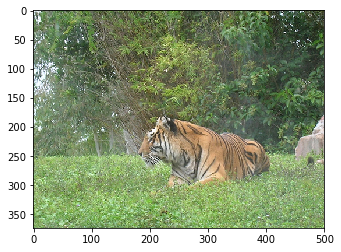

[(0.13419576, 'n02604954 Spadefish, angelfish, Chaetodipterus faber'),
 (0.096266612, 'n02129837 Bengal tiger'),
 (0.077061556, 'n03635330 Lame'),
 (0.055767674, 'n03318294 Fairy light'),
 (0.044234034, 'n04069276 Reflector')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
132


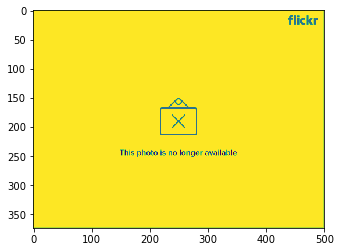

133
134
135


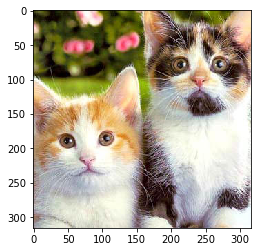

[(0.34894848, 'n03318294 Fairy light'),
 (0.20457415, 'n02123394 Persian cat'),
 (0.03247606, 'n03454885 Grater'),
 (0.031609084, 'n03666362 Light-emitting diode, LED'),
 (0.02519027, 'n02122948 Kitten, kitty')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
136


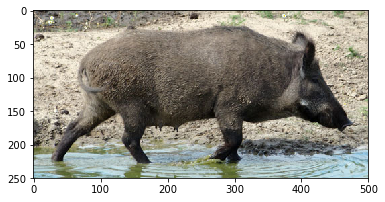

[(0.1109993,
  'n02418465 Mountain goat, Rocky Mountain goat, Oreamnos americanus'),
 (0.086674258, 'n02421136 Addax, Addax nasomaculatus'),
 (0.082523555,
  'n02425532 Nilgai, nylghai, nylghau, blue bull, Boselaphus tragocamelus'),
 (0.067052543, 'n02417534 Wild goat'),
 (0.064210169, 'n02416964 Nanny, nanny-goat, she-goat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
137


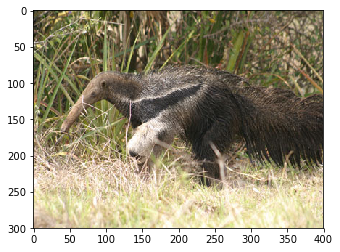

[(0.38966256, 'n02082791 Aardvark, ant bear, anteater, Orycteropus afer'),
 (0.1350138,
  'n02460451 Ant bear, giant anteater, great anteater, tamanoir, Myrmecophaga jubata'),
 (0.1076,
  'n01885498 Numbat, banded anteater, anteater, Myrmecobius fasciatus'),
 (0.072399922, 'n02460009 Anteater, New World anteater'),
 (0.063884117,
  'n02461128 Tamandua, tamandu, lesser anteater, Tamandua tetradactyla')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
138


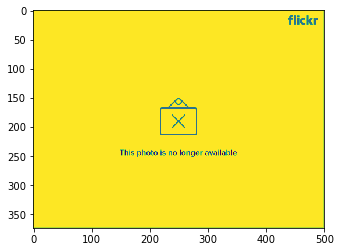

139


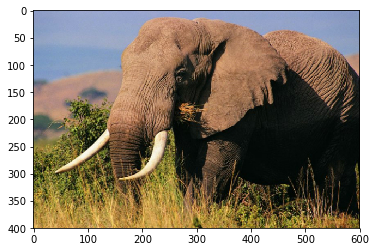

[(0.3654775, 'n02504458 African elephant, Loxodonta africana'),
 (0.063087121, 'n04072551 Rein'),
 (0.055841528, 'n03506028 Headstall, headpiece'),
 (0.042971238, 'n02503517 Elephant'),
 (0.023983657,
  'n02505063 Woolly mammoth, northern mammoth, Mammuthus primigenius')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
140


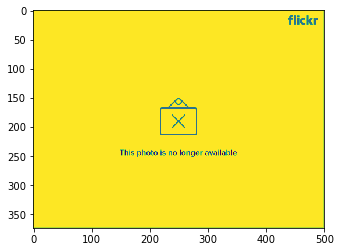

141
142


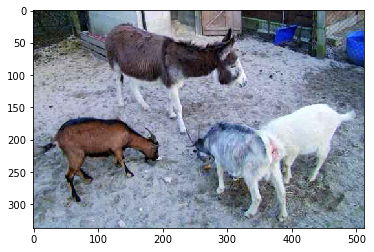

[(0.59663403, 'n02416820 Kid'),
 (0.080755644, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.067810081, 'n02416880 Billy, billy goat, he-goat'),
 (0.044021886, 'n03376159 Fold, sheepfold, sheep pen, sheepcote'),
 (0.015839824, 'n02417534 Wild goat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
Images tested: 100, Score: 0.0000
143


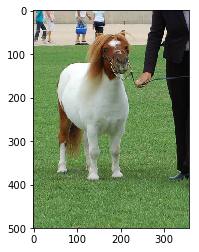

[(0.10620651, 'n13898207 Conformation'),
 (0.083836973, 'n02100399 Setter'),
 (0.04361359, 'n01323355 Sire'),
 (0.039930429, 'n02088238 Basset, basset hound'),
 (0.029642688, 'n02382437 Pony')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
144
145


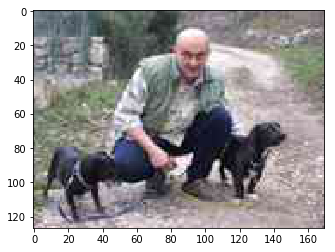

[(0.10158768, 'n00453478 Fox hunting, foxhunt'),
 (0.090346985, 'n00452864 Beagling'),
 (0.077603333, 'n02110806 Basenji'),
 (0.046181481, 'n10134178 Goat herder, goatherd'),
 (0.025723433, 'n02088992 Coondog')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
146


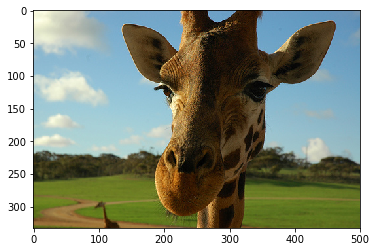

[(0.097118907, 'n02439033 Giraffe, camelopard, Giraffa camelopardalis'),
 (0.056108981, 'n03447075 Golf glove'),
 (0.055559728, 'n04528079 Verdigris'),
 (0.046380784, 'n01887623 Bull'),
 (0.039219048, 'n13897996 Balance, equilibrium, equipoise, counterbalance')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
147


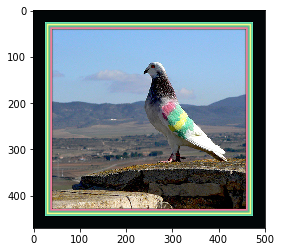

[(0.38463712, 'n01815036 Carrier pigeon'),
 (0.2261346, 'n01814755 Roller, tumbler, tumbler pigeon'),
 (0.11029079, 'n01812187 Pouter pigeon, pouter'),
 (0.082230404, 'n01814921 Homing pigeon, homer'),
 (0.043172292, 'n01812662 Rock dove, rock pigeon, Columba livia')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
148


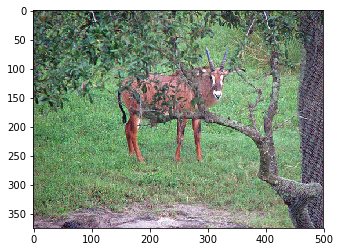

[(0.3327041,
  'n02432291 Virginia deer, white tail, whitetail, white-tailed deer, whitetail deer, Odocoileus Virginianus'),
 (0.25301188, 'n01888264 Buck'),
 (0.13721792, 'n02430830 Fawn'),
 (0.092457689, 'n02430045 Deer, cervid'),
 (0.047758821, 'n01888411 Doe')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
149
150


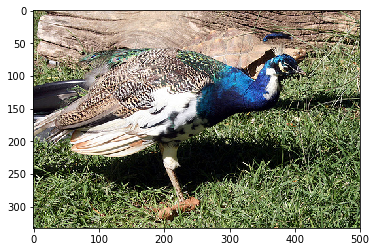

[(0.28691924, 'n01791463 Red jungle fowl, Gallus gallus'),
 (0.13940252, 'n01795735 European black grouse, heathfowl, Lyrurus tetrix'),
 (0.059239633, 'n01789386 Gallinaceous bird, gallinacean'),
 (0.044026807,
  "n01617766 Egyptian vulture, Pharaoh's chicken, Neophron percnopterus"),
 (0.030603169, 'n01791107 Jungle fowl, gallina')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
151


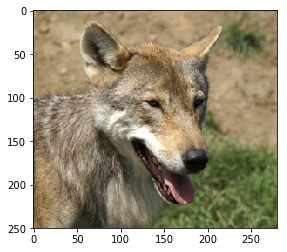

[(0.41206717, 'n02114855 Coyote, prairie wolf, brush wolf, Canis latrans'),
 (0.1194044, 'n02114100 Wolf'),
 (0.069057867, 'n02419056 Serow'),
 (0.049280912, 'n02120505 Grey fox, gray fox, Urocyon cinereoargenteus'),
 (0.038286168, 'n02114367 Timber wolf, grey wolf, gray wolf, Canis lupus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
152


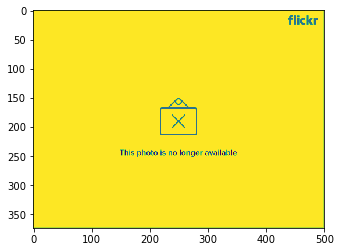

153


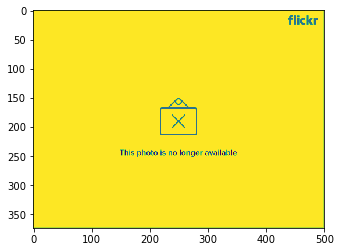

154


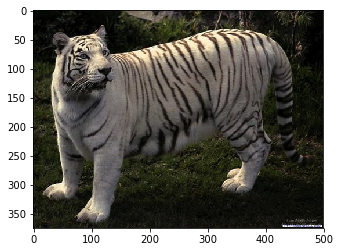

[(0.71680272, 'n02129837 Bengal tiger'),
 (0.065802388, 'n02129604 Tiger, Panthera tigris'),
 (0.05535391, 'n02129923 Tigress'),
 (0.046438333, 'n02123159 Tiger cat'),
 (0.018912325, 'n01323068 Tiger cub')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
155


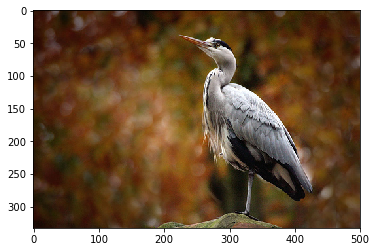

[(0.22735573, 'n02008041 Heron'),
 (0.22513853, 'n02009508 Little egret, Egretta garzetta'),
 (0.10351203, 'n02009912 American egret, great white heron, Egretta albus'),
 (0.10241287, 'n02008643 Great white heron, Ardea occidentalis'),
 (0.092150807, 'n02011016 Yellow-crowned night heron, Nyctanassa violacea')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
156
157


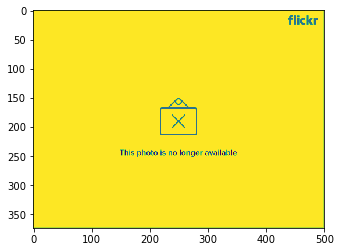

158


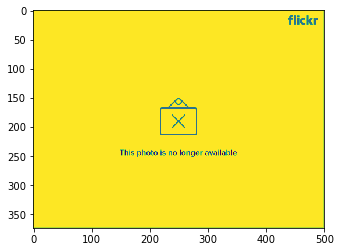

159


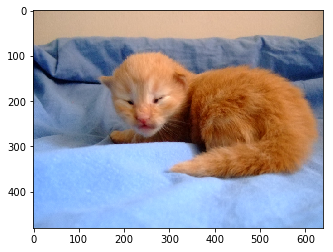

[(0.098585695, 'n02122948 Kitten, kitty'),
 (0.067264035, 'n02122298 Kitty, kitty-cat, puss, pussy, pussycat'),
 (0.0556725, 'n02121620 Cat, true cat'),
 (0.053519562,
  'n02121808 Domestic cat, house cat, Felis domesticus, Felis catus'),
 (0.048545875, 'n02982515 Cat box')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
160


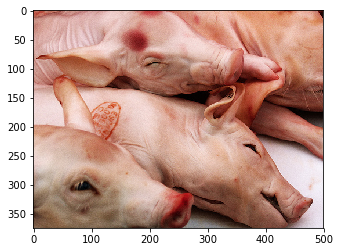

[(0.25576532, 'n02092339 Weimaraner'),
 (0.20623887, 'n02100735 English setter'),
 (0.096612915, 'n04157320 Sculpture'),
 (0.085820131, 'n02110341 Dalmatian, coach dog, carriage dog'),
 (0.031212157, 'n04439712 Tinfoil, tin foil')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
161


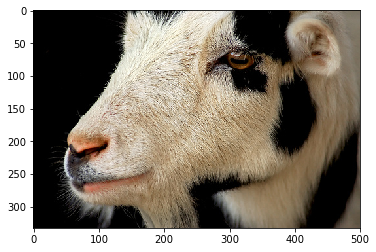

[(0.47610956, 'n02416880 Billy, billy goat, he-goat'),
 (0.32007495, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.050794605, 'n02417070 Domestic goat, Capra hircus'),
 (0.046697624, 'n02416519 Goat, caprine animal'),
 (0.033595923, 'n02416820 Kid')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
162


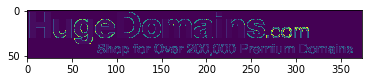

163


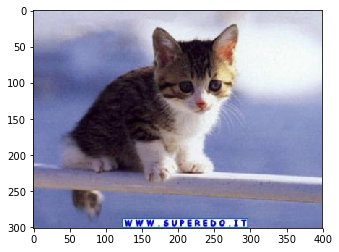

[(0.1174705,
  'n02121808 Domestic cat, house cat, Felis domesticus, Felis catus'),
 (0.10715414, 'n02124484 Manx, Manx cat'),
 (0.085553922, 'n02499808 Galago, bushbaby, bush baby'),
 (0.081616737, 'n02120997 Feline, felid'),
 (0.068099752, 'n02125081 European wildcat, catamountain, Felis silvestris')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
164


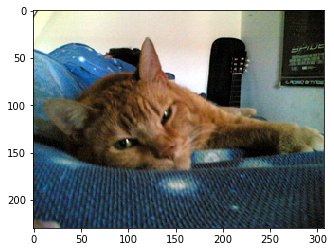

[(0.099787399, 'n02122298 Kitty, kitty-cat, puss, pussy, pussycat'),
 (0.08877933, 'n02097298 Scotch terrier, Scottish terrier, Scottie'),
 (0.051409326, 'n02122430 Mouser'),
 (0.039774571, 'n03565830 In-basket, in-tray'),
 (0.035652574, 'n02328150 Angora, Angora rabbit')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
165


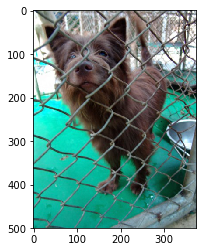

[(0.047523111, 'n03993703 Pound, dog pound'),
 (0.042320162, 'n02127292 Common lynx, Lynx lynx'),
 (0.040709656, 'n02494079 Squirrel monkey, Saimiri sciureus'),
 (0.034282178, 'n02492660 Howler monkey, howler'),
 (0.029319493, 'n02123394 Persian cat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
166
167


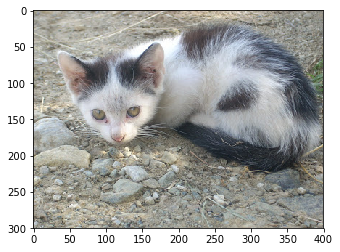

[(0.13705444, 'n04439712 Tinfoil, tin foil'),
 (0.043736234, 'n01314663 Critter'),
 (0.039611995, 'n03665366 Light, light source'),
 (0.036870502, 'n01884203 Native cat, Dasyurus viverrinus'),
 (0.03609838, 'n02122298 Kitty, kitty-cat, puss, pussy, pussycat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
168
169


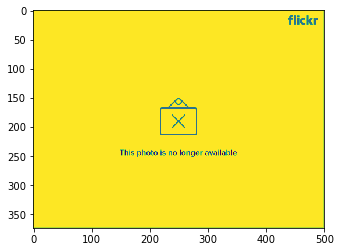

170
171
172


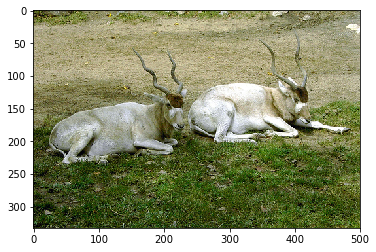

[(0.79877812, 'n02421136 Addax, Addax nasomaculatus'),
 (0.051477633, 'n02604954 Spadefish, angelfish, Chaetodipterus faber'),
 (0.020544732, 'n02404906 Zebu'),
 (0.011787388, 'n02419796 Antelope'),
 (0.0098259803, 'n02174001 Rhinoceros beetle')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
173
174


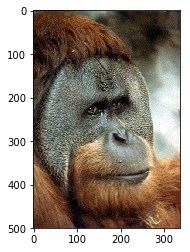

[(0.51076937,
  'n02483708 Siamang, Hylobates syndactylus, Symphalangus syndactylus'),
 (0.079225667, 'n02470325 Ape'),
 (0.073877215, 'n02484322 Monkey'),
 (0.06015043, 'n02457408 Three-toed sloth, ai, Bradypus tridactylus'),
 (0.05049875, 'n02469914 Primate')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
175


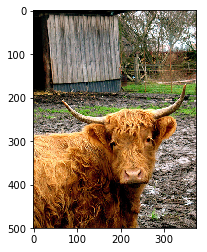

[(0.39550522, 'n02403231 Bullock, steer'),
 (0.37030891, 'n02404432 Longhorn, Texas longhorn'),
 (0.06874685, 'n04439712 Tinfoil, tin foil'),
 (0.04739375, 'n02405302 Yak, Bos grunniens'),
 (0.038334172, 'n02417387 Angora, Angora goat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
176


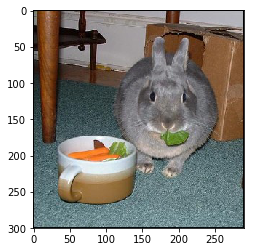

[(0.37017077, 'n02324587 Bunny, bunny rabbit'),
 (0.18051869, 'n02323449 Lagomorph, gnawing mammal'),
 (0.1579939, 'n02324045 Rabbit, coney, cony'),
 (0.11963528, 'n02324431 Rabbit ears'),
 (0.079703704, 'n02324514 Lapin')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
177


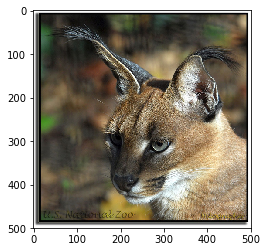

[(0.12484935, 'n03325088 Faucet, spigot'),
 (0.11630382, 'n02137015 Genet, Genetta genetta'),
 (0.067268811, 'n04559451 Water faucet, water tap, tap, hydrant'),
 (0.059049897, 'n13881644 Star'),
 (0.050098468, 'n04439712 Tinfoil, tin foil')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
178
179


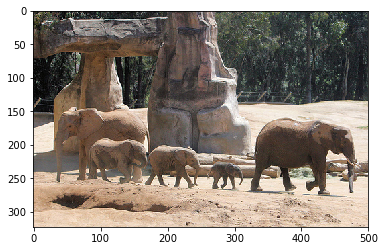

[(0.57866412, 'n02416820 Kid'),
 (0.087781295, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.030917421, 'n02416880 Billy, billy goat, he-goat'),
 (0.023233389,
  'n02418465 Mountain goat, Rocky Mountain goat, Oreamnos americanus'),
 (0.022888791, 'n02421136 Addax, Addax nasomaculatus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
180


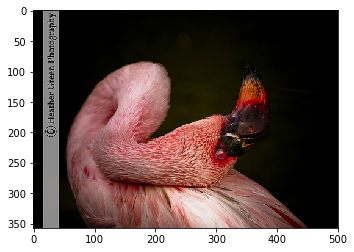

[(0.056159247, 'n03499354 Hatpin'),
 (0.043050617, 'n03635330 Lame'),
 (0.031799134, 'n13918274 Tail, tail end'),
 (0.029506197, 'n02796318 Barrette'),
 (0.024045562, 'n04969952 Purplish blue, royal blue')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
181


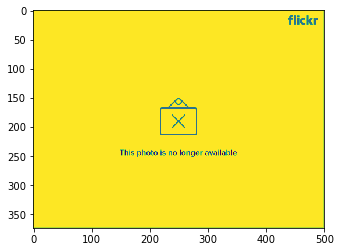

182


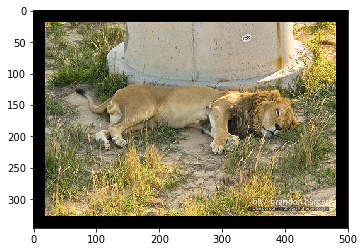

[(0.14184245, 'n02416820 Kid'),
 (0.09163174, 'n00452864 Beagling'),
 (0.069709018, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.066281758, 'n04439712 Tinfoil, tin foil'),
 (0.03637192, 'n02083672 Bitch')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
183


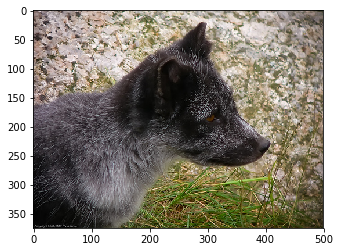

[(0.61249572, 'n02105056 Groenendael'),
 (0.1710009, 'n02104882 Belgian sheepdog, Belgian shepherd'),
 (0.078722805, 'n02114100 Wolf'),
 (0.047914702, 'n02114367 Timber wolf, grey wolf, gray wolf, Canis lupus'),
 (0.021212965, 'n02114548 White wolf, Arctic wolf, Canis lupus tundrarum')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
184


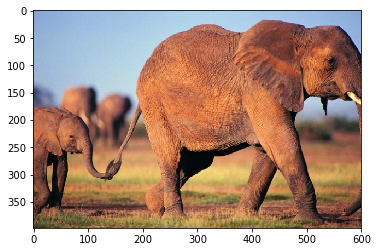

[(0.25885507, 'n02381364 Grey, gray'),
 (0.11633913, 'n02504458 African elephant, Loxodonta africana'),
 (0.091330253, 'n02437312 Arabian camel, dromedary, Camelus dromedarius'),
 (0.061002091, 'n01704323 Triceratops'),
 (0.025341574, 'n02404573 Brahman, Brahma, Brahmin, Bos indicus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
185


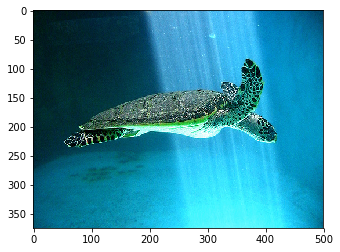

[(0.25141877, 'n01663782 Green turtle, Chelonia mydas'),
 (0.10859488,
  'n01665541 Leatherback turtle, leatherback, leathery turtle, Dermochelys coriacea'),
 (0.085290685, 'n01663401 Sea turtle, marine turtle'),
 (0.045803003,
  'n01664674 Pacific ridley, olive ridley, Lepidochelys olivacea'),
 (0.0356998, 'n02534734 Salmon')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
186


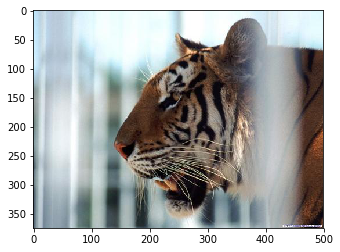

[(0.31652206, 'n04439712 Tinfoil, tin foil'),
 (0.18859702,
  'n03005619 Chanfron, chamfron, testiere, frontstall, front-stall'),
 (0.039282881, 'n02895154 Breastplate, aegis, egis'),
 (0.037752908,
  'n02373336 Odd-toed ungulate, perissodactyl, perissodactyl mammal'),
 (0.016342124, 'n02512053 Fish')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
187


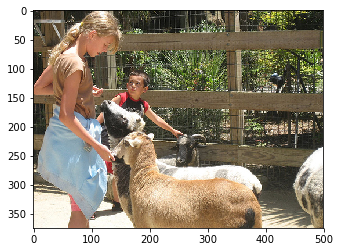

[(0.15727206, 'n04439712 Tinfoil, tin foil'),
 (0.083196871, 'n04339879 Strip lighting'),
 (0.064132303, 'n04340521 Stroboscope, strobe, strobe light'),
 (0.058116682, 'n13864035 Bulb'),
 (0.039801937, 'n02895154 Breastplate, aegis, egis')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
188


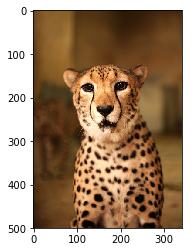

[(0.048521686, 'n03923379 Phial, vial, ampule, ampul, ampoule'),
 (0.044457011, 'n01623880 Spotted owl, Strix occidentalis'),
 (0.039431114, 'n02120997 Feline, felid'),
 (0.033738349, 'n04522168 Vase'),
 (0.026895761, 'n01318381 Head')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
189


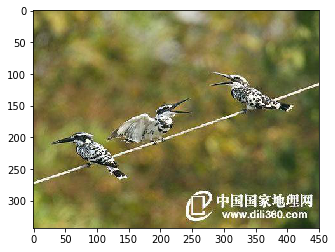

[(0.35942394, 'n02243562 Water strider, pond-skater, water skater'),
 (0.17886022, 'n01828096 Belted kingfisher, Ceryle alcyon'),
 (0.09363775, 'n03666362 Light-emitting diode, LED'),
 (0.084032208, 'n01827403 Kingfisher'),
 (0.044246655, 'n04594218 Wire')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
190


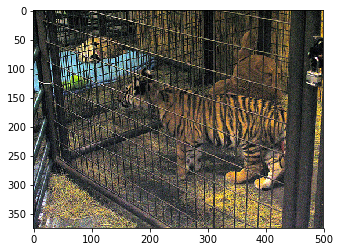

[(0.098282702, 'n02843276 Birdcage'),
 (0.090681821, 'n03993703 Pound, dog pound'),
 (0.053815972, 'n02754656 Atrium'),
 (0.051977396, 'n02936714 Cage, coop'),
 (0.046063077, 'n04475411 Trapeze')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
191


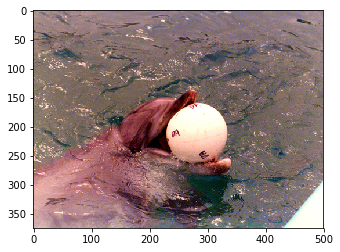

[(0.30629569, 'n01850192 Bufflehead, butterball, dipper, Bucephela albeola'),
 (0.20439155, 'n01847253 Diving duck'),
 (0.056301191, 'n09191635 Air bubble'),
 (0.034691382, 'n09300905 Hail'),
 (0.019017106,
  'n01319467 Marine animal, marine creature, sea animal, sea creature')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
192


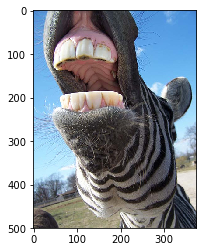

[(0.068338156, 'n04439712 Tinfoil, tin foil'),
 (0.067590579, 'n02895154 Breastplate, aegis, egis'),
 (0.055775549,
  'n02740764 Armor plate, armour plate, armor plating, plate armor, plate armour'),
 (0.055123273, 'n03665366 Light, light source'),
 (0.048586633, 'n03429771 Gauntlet, gantlet, metal glove')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
193


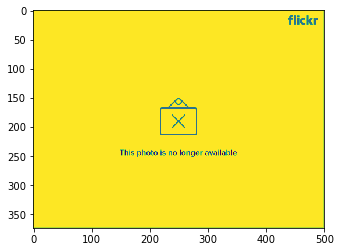

194
195


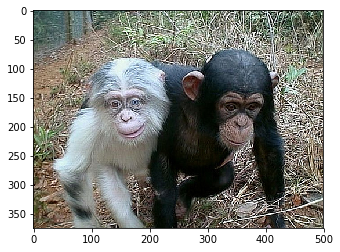

[(0.23837411, 'n02470238 Simian'),
 (0.14331385, 'n02484322 Monkey'),
 (0.1384306, 'n02484473 Old World monkey, catarrhine'),
 (0.075442992, 'n02482650 Pygmy chimpanzee, bonobo, Pan paniscus'),
 (0.047952972, 'n02470325 Ape')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
196


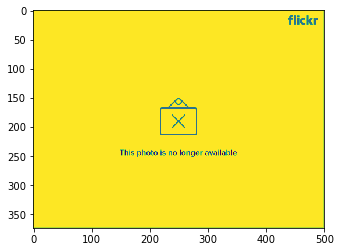

197


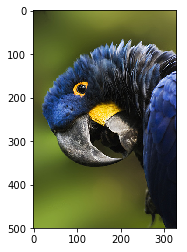

[(0.08268781, 'n03221059 Domino, half mask, eye mask'),
 (0.0611718, 'n02607201 Clown anemone fish, Amphiprion percula'),
 (0.056575634, 'n02607072 Anemone fish'),
 (0.037219133, 'n03359137 Flashlight, torch'),
 (0.036090158,
  'n01756089 Prairie rattlesnake, prairie rattler, Western rattlesnake, Crotalus viridis')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
198


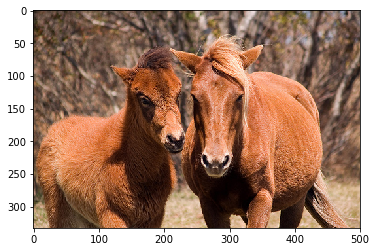

[(0.35545018, 'n02416820 Kid'),
 (0.22593442, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.087871499, 'n02416880 Billy, billy goat, he-goat'),
 (0.027221555, 'n02417387 Angora, Angora goat'),
 (0.024677416, 'n02417070 Domestic goat, Capra hircus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
199


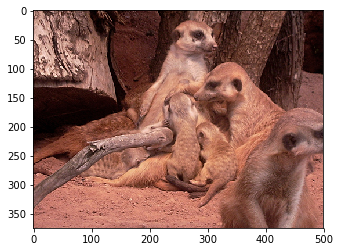

[(0.63700598, 'n04439712 Tinfoil, tin foil'),
 (0.023410697, 'n02100735 English setter'),
 (0.020722656, 'n02088632 Bluetick'),
 (0.017786037, 'n02091134 Whippet'),
 (0.016558198, 'n02100399 Setter')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
200


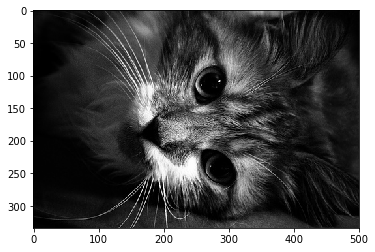

[(0.45345184, 'n01318894 Pet'),
 (0.051184479, 'n03318294 Fairy light'),
 (0.043525044, 'n02094433 Yorkshire terrier'),
 (0.040823825, 'n01317541 Domestic animal, domesticated animal'),
 (0.028660459, 'n02123045 Tabby, tabby cat')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
201


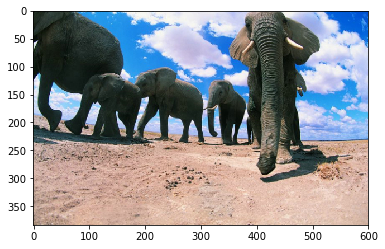

[(0.15668777, 'n03665366 Light, light source'),
 (0.087664083, 'n04456115 Torch'),
 (0.058000408, 'n03346135 Fire iron'),
 (0.042219788, 'n02504458 African elephant, Loxodonta africana'),
 (0.027311781, 'n02374149 Equine, equid')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
202


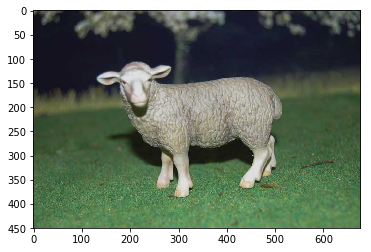

[(0.094759181, 'n02416880 Billy, billy goat, he-goat'),
 (0.089836739, 'n02417070 Domestic goat, Capra hircus'),
 (0.080328479, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.062114485, 'n02412440 Lamb'),
 (0.057622746, 'n02416820 Kid')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
203


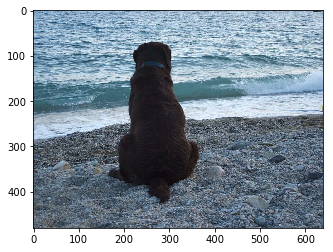

[(0.22438817, 'n02138441 Meerkat, mierkat'),
 (0.15223038, 'n02138777 Suricate, Suricata tetradactyla'),
 (0.079880893, 'n02137549 Mongoose'),
 (0.069657348, 'n01790304 Plymouth Rock'),
 (0.038771961, 'n02138647 Slender-tailed meerkat, Suricata suricatta')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
204


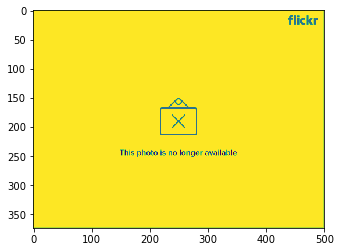

205
206


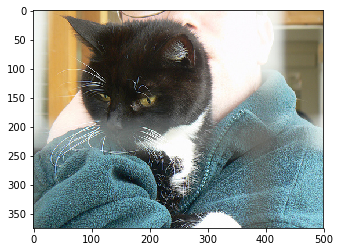

[(0.14321297, 'n02122430 Mouser'),
 (0.10712652, 'n02122298 Kitty, kitty-cat, puss, pussy, pussycat'),
 (0.090550892, 'n04953296 Glint'),
 (0.078194983, 'n04571958 Weld'),
 (0.073924378,
  'n02121808 Domestic cat, house cat, Felis domesticus, Felis catus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
207


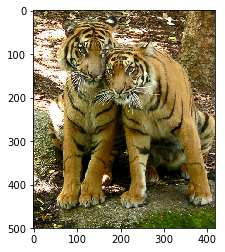

[(0.19440018, 'n02129837 Bengal tiger'),
 (0.062757663, 'n02129923 Tigress'),
 (0.062522888, 'n03914438 Pepper shaker, pepper box, pepper pot'),
 (0.053098634, 'n04266375 Spacesuit'),
 (0.037241492, 'n02129604 Tiger, Panthera tigris')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
208


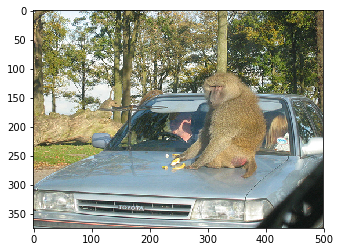

[(0.15493107, 'n04439712 Tinfoil, tin foil'),
 (0.14699765, 'n04590553 Windshield, windscreen'),
 (0.0510755, 'n02960352 Car, elevator car'),
 (0.030388797, 'n04357121 Sunroof, sunshine-roof'),
 (0.026826486, 'n03503997 Headlight, headlamp')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
209


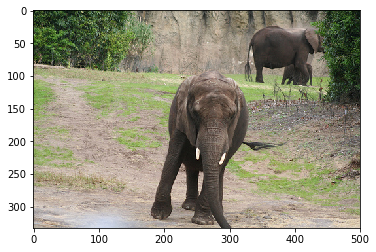

[(0.092275031, 'n02092339 Weimaraner'),
 (0.08574222, 'n02504458 African elephant, Loxodonta africana'),
 (0.076997265,
  'n02432291 Virginia deer, white tail, whitetail, white-tailed deer, whitetail deer, Odocoileus Virginianus'),
 (0.070052147, 'n01888045 Calf'),
 (0.059421193, 'n01888411 Doe')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
210
211


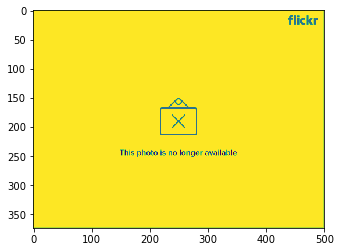

212


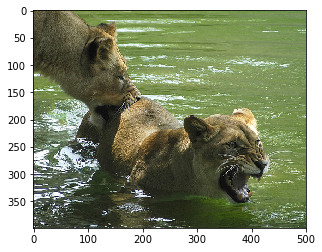

[(0.2148674, 'n02406647 Charolais'),
 (0.15653343,
  'n02398521 Hippopotamus, hippo, river horse, Hippopotamus amphibius'),
 (0.10197876, 'n02416964 Nanny, nanny-goat, she-goat'),
 (0.051047161, 'n02097786 Skye terrier'),
 (0.047219556, 'n02416820 Kid')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
213


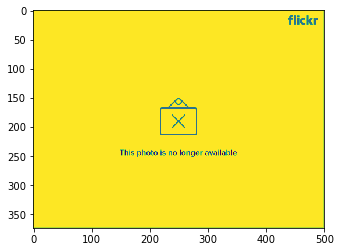

214


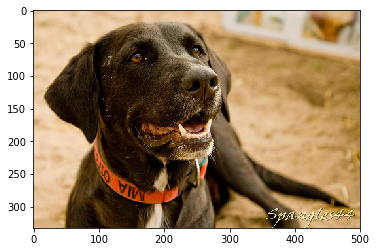

[(0.44323239, 'n02100236 German short-haired pointer'),
 (0.3950071, 'n02099997 Pointer, Spanish pointer'),
 (0.10258116, 'n02092339 Weimaraner'),
 (0.0095984843, 'n02088839 Coonhound'),
 (0.0089767184, 'n02099849 Chesapeake Bay retriever')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
215


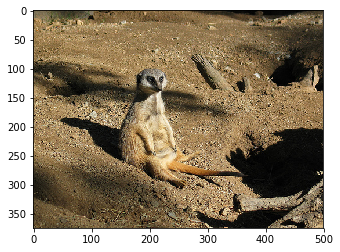

[(0.15443641, 'n02055803 Penguin'),
 (0.12326431, 'n02619550 Mudskipper, mudspringer'),
 (0.076748811, 'n09443641 Spume'),
 (0.049091373, 'n01847253 Diving duck'),
 (0.044203117, 'n02057035 Jackass penguin, Spheniscus demersus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
216


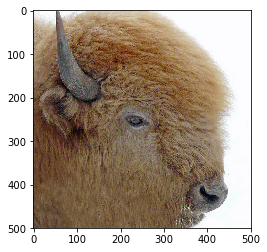

[(0.22411782, 'n02403231 Bullock, steer'),
 (0.19980156, 'n01887623 Bull'),
 (0.11299829, 'n02402175 Ox, wild ox'),
 (0.056728035,
  'n02408429 Water buffalo, water ox, Asiatic buffalo, Bubalus bubalis'),
 (0.053332649, 'n02405101 Aurochs, urus, Bos primigenius')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
Images tested: 150, Score: 0.0000
217


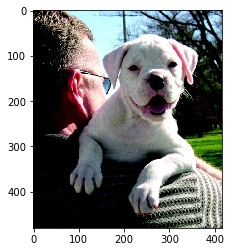

[(0.60252434, 'n04439712 Tinfoil, tin foil'),
 (0.10952282, 'n02108089 Boxer'),
 (0.042385828, 'n03318294 Fairy light'),
 (0.025668493, 'n02096585 Boston bull, Boston terrier'),
 (0.016663397, 'n02084732 Pooch, doggie, doggy, barker, bow-wow')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
218


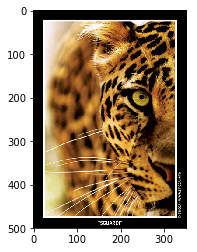

[(0.12895192, 'n04260364 Sonogram, echogram'),
 (0.11497201, 'n05467758 Astrocyte'),
 (0.044619065, 'n01416213 Zooid'),
 (0.033857461, 'n04485423 Triptych'),
 (0.032144804, 'n09461069 Trapezium')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
219


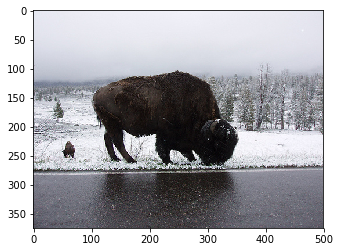

[(0.20445487, 'n02408817 Carabao'),
 (0.12178022,
  'n02408429 Water buffalo, water ox, Asiatic buffalo, Bubalus bubalis'),
 (0.088081151, 'n02392434 Indian rhinoceros, Rhinoceros unicornis'),
 (0.051782705, 'n02407959 Old World buffalo, buffalo'),
 (0.040611312, 'n02504458 African elephant, Loxodonta africana')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
220


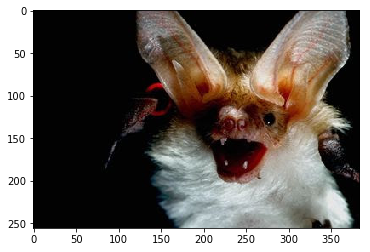

[(0.16351695, 'n03362890 Fleur-de-lis, fleur-de-lys'),
 (0.074815623, 'n02097047 Miniature schnauzer'),
 (0.046239618, 'n02096756 Schnauzer'),
 (0.030762099, 'n01519563 Cassowary'),
 (0.02636157, 'n03635330 Lame')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
221


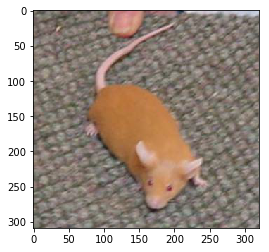

[(0.29832432, 'n03506560 Hearing aid, ear trumpet'),
 (0.22212923, 'n03506727 Hearing aid, deaf-aid'),
 (0.098308548, 'n02330245 Mouse'),
 (0.045835767, 'n03666362 Light-emitting diode, LED'),
 (0.035375956, 'n04589890 Window screen')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
222


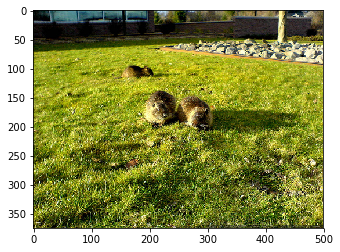

[(0.12497655, 'n00442115 Swimming, swim'),
 (0.05566705, 'n09191635 Air bubble'),
 (0.039806668, 'n00443231 Floating, natation'),
 (0.030606236, 'n04542858 Wading pool'),
 (0.025118636, 'n04095342 Rivet')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
223
224


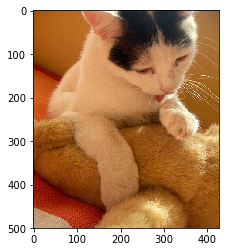

[(0.23846599, 'n02122298 Kitty, kitty-cat, puss, pussy, pussycat'),
 (0.078124203, 'n03970546 Plush'),
 (0.072036356, 'n02122948 Kitten, kitty'),
 (0.052306402, 'n02124484 Manx, Manx cat'),
 (0.043008965,
  'n02121808 Domestic cat, house cat, Felis domesticus, Felis catus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
225
226


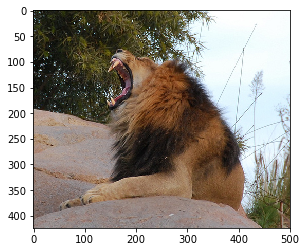

[(0.19371872, 'n02114548 White wolf, Arctic wolf, Canis lupus tundrarum'),
 (0.083303079, 'n02090721 Irish wolfhound'),
 (0.055103097, 'n02090475 Wolfhound'),
 (0.038302042, 'n04579986 White'),
 (0.034576293,
  'n02134084 Ice bear, polar bear, Ursus Maritimus, Thalarctos maritimus')]
Correct class: n00015388, Animal, animate being, beast, brute, creature, fauna
227


KeyboardInterrupt: 

In [14]:
score = evaluate_rank(net, test_img_urls, labels_dict, 5)
print('\nScore: %.4f' % score)